#**Challenge Chapter 2**
####Studi Kasus Prediksi Customer Churn

#**Task Overview:**

*   **Reading Data:** import dan eksplorasi dataset
*   **Data Cleaning:** membersihkan data dari data duplikat, missing value, messy string dan cek outliers
*   **Exploratory Data Analysis:** analisis dan eksplorasi dataset untuk menghasilkan insight
*   **Preprocessing**: normalisasi data, feature engineering, dan balancing data
*   **Modeling**: pembuatan model dengan algoritma machine learning
*   **Evaluation**: mengevaluasi performa model
*   **Prediction**: memprediksi customer churn menggunakan model yang dibuat



---


#**Business Understanding**

##**Problem Statement**
Di era digital yang dipenuhi dengan persaingan yang ketat di industri telekomunikasi, perusahaan-perusahaan sering kali berjuang keras untuk mempertahankan basis customer mereka. Salah satu tantangan utama yang dihadapi oleh penyedia layanan telekomunikasi adalah tingkat churn customer yang tinggi. Churn customer, yang merujuk pada fenomena dimana customer beralih dari satu penyedia layanan ke penyedia lain, dapat mengakibatkan kerugian finansial dan mempengaruhi reputasi perusahaan. Prediksi churn customer menjadi krusial bagi perusahaan telekomunikasi untuk dapat mengantisipasi dan mengurangi kehilangan customer. Oleh karena itu, diperlukan pengembangan Machine Learning yang mampu memprediksi churn customer dengan tingkat akurasi yang optimal, sehingga memungkinkan perusahaan untuk mengambil tindakan proaktif dalam mempertahankan customer dan meningkatkan retensi customer secara efektif.

##**Objective**
Membangun model klasifikasi menggunakan machine learning yang dapat mengenali dan memprediksi customer yang berpotensi untuk melakukan churn (berhenti berlangganan/beralih) dari layanan telekomunikasi. Dengan demikian perusahaan dapat melakukan pengambilan keputusan yang proaktif dalam mempertahankan customer dan meningkatkan retensi customer secara efektif.



---


Sebelum melakukan analisis dan eksplorasi, berikut ini penjelasan dari masing-masing feature/kolom dari dataset yang digunakan.

1. **State**: Menunjukkan negara bagian tempat customer berada.
2. **Account length**: Menunjukkan jumlah bulan customer telah menjadi customer di perusahaan telekomunikasi.
3. **Area code**: Kode area telepon customer.
4. **International plan**: Menunjukkan apakah customer memiliki paket internasional atau tidak (Yes/No).
5. **Voice mail plan**: Menunjukkan apakah customer memiliki paket pesan suara atau tidak (Yes/No).
6. **Number vmail messages**: Jumlah pesan suara yang diterima oleh customer.
7. **Total day minutes**: Total menit yang digunakan customer selama siang hari.
8. **Total day calls**: Total panggilan yang dilakukan customer selama siang hari.
9. **Total day charge**: Total biaya yang dibebankan kepada customer untuk panggilan siang hari (06.00 - 18.00).
10. **Total eve minutes**: Total menit yang digunakan customer selama malam hari.
11. **Total eve calls**: Total panggilan yang dilakukan customer selama malam hari.
12. **Total eve charge**: Total biaya yang dibebankan kepada customer untuk panggilan malam hari (18.00 - 22.00).
13. **Total night minutes**: Total menit yang digunakan customer selama malam hari.
14. **Total night calls**: Total panggilan yang dilakukan customer selama malam hari.
15. **Total night charge**: Total biaya yang dibebankan kepada customer untuk panggilan malam hari (22.00 - 06.00).
16. **Total intl minutes**: Total menit yang digunakan customer untuk panggilan internasional.
17. **Total intl calls**: Total panggilan internasional yang dilakukan oleh customer.
18. **Total intl charge**: Total biaya yang dibebankan kepada customer untuk panggilan internasional.
19. **Customer service calls**: Jumlah panggilan layanan customer yang dilakukan oleh customer.
20. **Churn**: Menunjukkan apakah customer berhenti menggunakan layanan (Churn/Not Churn).




#**Reading Data**

##**Import Library**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


##**Load Data**

In [ ]:
df_train = pd.read_csv('/content/drive/MyDrive/Latihan Analisis Data /FGA/FGA-DATA SCIENCE-BINAR/Data Train.csv')

In [ ]:
df_train.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,no
1,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,no
2,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,no
3,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,no
4,MA,121,area_code_510,no,yes,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,no


In [ ]:
#mengecek informasi data
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4250 entries, 0 to 4249
Data columns (total 20 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   state                          4250 non-null   object 
 1   account_length                 4250 non-null   int64  
 2   area_code                      4250 non-null   object 
 3   international_plan             4250 non-null   object 
 4   voice_mail_plan                4250 non-null   object 
 5   number_vmail_messages          4250 non-null   int64  
 6   total_day_minutes              4250 non-null   float64
 7   total_day_calls                4250 non-null   int64  
 8   total_day_charge               4250 non-null   float64
 9   total_eve_minutes              4250 non-null   float64
 10  total_eve_calls                4250 non-null   int64  
 11  total_eve_charge               4250 non-null   float64
 12  total_night_minutes            4250 non-null   f

In [ ]:
#mengecek jumlah kolom dan baris pada data
print(f'Jumlah baris: {df_train.shape[0]}, jumlah kolom: {df_train.shape[1]}')

Jumlah baris: 4250, jumlah kolom: 20


In [ ]:
#mengecek tipe data tiap kolom
df_train.dtypes

state                             object
account_length                     int64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

In [ ]:
#melihat statistik desktriptif dari data numerik
df_train.describe(exclude='object')

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
count,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000
mean,100.236235,7.631765,180.259600,99.907294,30.644682,200.173906,100.176471,17.015012,200.527882,99.839529,9.023892,10.256071,4.426353,2.769654,1.559059
std,39.698401,13.439882,54.012373,19.850817,9.182096,50.249518,19.908591,4.271212,50.353548,20.093220,2.265922,2.760102,2.463069,0.745204,1.311434
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,73.000000,0.000000,143.325000,87.000000,24.365000,165.925000,87.000000,14.102500,167.225000,86.000000,7.522500,8.500000,3.000000,2.300000,1.000000
50%,100.000000,0.000000,180.450000,100.000000,30.680000,200.700000,100.000000,17.060000,200.450000,100.000000,9.020000,10.300000,4.000000,2.780000,1.000000
75%,127.000000,16.000000,216.200000,113.000000,36.750000,233.775000,114.000000,19.867500,234.700000,113.000000,10.560000,12.000000,6.000000,3.240000,2.000000
max,243.000000,52.000000,351.500000,165.000000,59.760000,359.300000,170.000000,30.540000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000


In [ ]:
#melihat statistik deskriptif dari data object
df_train.describe(include='object')

,state,area_code,international_plan,voice_mail_plan,churn
count,4250,4250,4250,4250,4250
unique,51,3,2,2,2
top,WV,area_code_415,no,no,no
freq,139,2108,3854,3138,3652


##**Data Unique & Frequency**

###**Kolom Numerik**

In [ ]:
#mengumpulkan kolom numerik
kolom_numerik = df_train.select_dtypes(exclude='object')

#menampilkan data unique dan frequency kolom numerik
for kolom in kolom_numerik.columns:
  nilai_unique = df_train[kolom].unique()
  nilai_frekuensi = df_train[kolom].value_counts()
  print(f'Nilai unique dari kolom {kolom}: {nilai_unique} \n \nNilai frekuensi dari kolom {nilai_frekuensi} \n')
  print('-------------')

Nilai unique dari kolom account_length: [107 137  84  75 121 147 117 141  65  74 168  95 161  85  76  73  77 130
 111 132  57  54  20  49  12  36  78 136  98 135  34 160  64  59 142  97
  52  60  10  96  81 125 174 116 149  38  40  43 113 126 150 138 162  90
  50  82 144  46  70 128  94 155  80  99 120 108 122  93 157  63  41 193
  61  92 163  91 127 110 103 145  56 151  83 139   6 115  62 185 148  32
  68  25 179  67  19 170 106  51 118 208 131  53 105  66  35  88 123  45
 100 215  22  33  86 114  24 119 101 146 143  48 167  89 199 166 158 196
 112 209  16  39 104 129  55  44  79 159 194  87  21 133 224 140  58 109
  71  72 124 102 165  18  30 190  47 152  26  69  31 186 171  28 153 172
 169  13 189 176 156  37  27 134 243  42  23   1 200   5 178 181 182 217
 164 177  11   9 173 154  29 180   3   2   7 232 192 195 197 225 191 201
  15  17 183 212 210 175   4 184 188 204 221 187  14 216 222   8 202] 
 
Nilai frekuensi dari kolom account_length
90     53
87     51
93     50
105    48
10

###**Kolom Kategorik**

In [ ]:
#mengumpulkan kolom kategorik
kolom_kategorik = df_train.select_dtypes(include='object')

#menampilkan data unique dan frequency kolom kategorik
for kolom in kolom_kategorik.columns:
  nilai_unique = df_train[kolom].unique()
  nilai_frekuensi = df_train[kolom].value_counts()
  print(f'Nilai unique dari kolom {kolom}: {nilai_unique} \n \nNilai frekuensi dari kolom {nilai_frekuensi} \n')
  print('-------------')

Nilai unique dari kolom state: ['OH' 'NJ' 'OK' 'MA' 'MO' 'LA' 'WV' 'IN' 'RI' 'IA' 'MT' 'NY' 'ID' 'VA'
 'TX' 'FL' 'CO' 'AZ' 'SC' 'WY' 'HI' 'NH' 'AK' 'GA' 'MD' 'AR' 'WI' 'OR'
 'MI' 'DE' 'UT' 'CA' 'SD' 'NC' 'WA' 'MN' 'NM' 'NV' 'DC' 'VT' 'KY' 'ME'
 'MS' 'AL' 'NE' 'KS' 'TN' 'IL' 'PA' 'CT' 'ND'] 
 
Nilai frekuensi dari kolom state
WV    139
MN    108
ID    106
AL    101
VA    100
OR     99
TX     98
UT     97
NY     96
NJ     96
WY     95
OH     95
WI     94
MA     89
ME     89
CT     88
RI     87
MI     87
KS     87
MD     86
VT     86
KY     85
NV     83
IN     83
MS     82
WA     80
NC     80
MO     80
DE     80
CO     80
MT     80
IL     79
TN     79
NM     78
OK     78
NH     78
HI     77
AZ     77
FL     76
SD     75
NE     73
DC     72
SC     72
AR     71
LA     69
PA     67
ND     67
GA     64
IA     62
AK     61
CA     39
Name: count, dtype: int64 

-------------
Nilai unique dari kolom area_code: ['area_code_415' 'area_code_408' 'area_code_510'] 
 
Nilai frekuensi dari kolom area_c

#**Data Cleaning**

##**Cek Data Duplikat**

In [ ]:
#mengecek apakah ada data yg terduplikat
print(f'Jumlah data terduplikat:\n{df_train[df_train.duplicated()].sum()}')

Jumlah data terduplikat:
state                              0
account_length                     0
area_code                          0
international_plan                 0
voice_mail_plan                    0
number_vmail_messages              0
total_day_minutes                0.0
total_day_calls                    0
total_day_charge                 0.0
total_eve_minutes                0.0
total_eve_calls                    0
total_eve_charge                 0.0
total_night_minutes              0.0
total_night_calls                  0
total_night_charge               0.0
total_intl_minutes               0.0
total_intl_calls                   0
total_intl_charge                0.0
number_customer_service_calls      0
churn                              0
dtype: object


Berdasarkan pengecekan di atas, tidak terdapat data yang terduplikat.

##**Cek Missing Value**

In [ ]:
print(f'Jumlah missing value: \n{df_train.isnull().sum()}')

Jumlah missing value: 
state                            0
account_length                   0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
churn                            0
dtype: int64


Berdasarkan pengecekan di atas, tidak terdapat missing value pada data.



> **Messy String:** setelah dilakukan eksplorasi data unique dan frequency, dapat disimpulkan bahwa data tidak memiliki messy string.



##**Cek Outliers**

###**Cek distribusi data dengan Histogram**

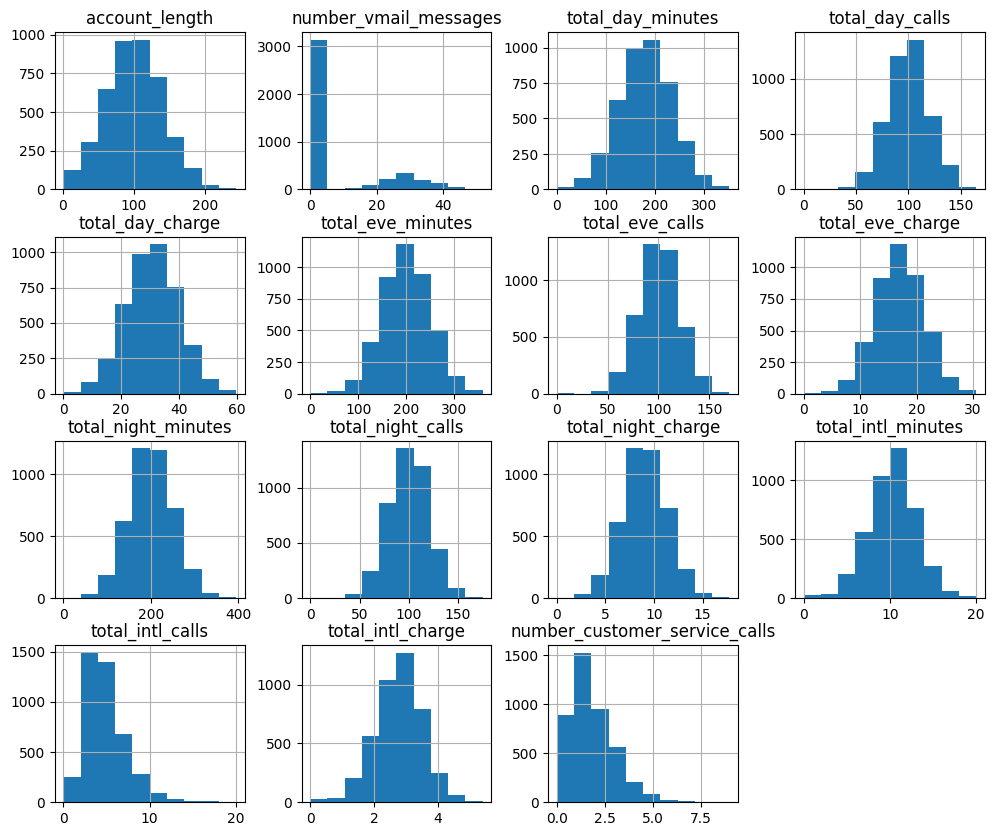

In [ ]:
#cek distribusi dari data
df_train.hist(figsize=(12,10))
plt.show()

Berdasarkan visualisasi di atas, terlihat banyak kolom yang tidak berdistribusi normal dan terlihat terdapat outlier dalam data.

###**Detect Outlier dengan Boxplot**

In [ ]:
def box_plot(data):
  # Jumlah kolom dalam satu baris dan jumlah baris yang diinginkan
  kolom_per_baris = 3
  jumlah_kolom = len(kolom_numerik.columns)
  jumlah_baris = (jumlah_kolom + kolom_per_baris - 1) // kolom_per_baris

  # Membuat subplots dengan tata letak grid yang diinginkan
  fig, axes = plt.subplots(nrows=jumlah_baris, ncols=kolom_per_baris, figsize=(10, 3 * jumlah_baris))

  # Menyusun boxplot ke dalam subplots
  for i, kolom in enumerate(kolom_numerik.columns):
      baris = i // kolom_per_baris
      kolom_di_baris = i % kolom_per_baris
      sns.boxplot(data=data, x=kolom, ax=axes[baris, kolom_di_baris])
      axes[baris, kolom_di_baris].set_title(kolom)

  # Mengatur tata letak dan menampilkan plot
  plt.tight_layout()
  plt.show()

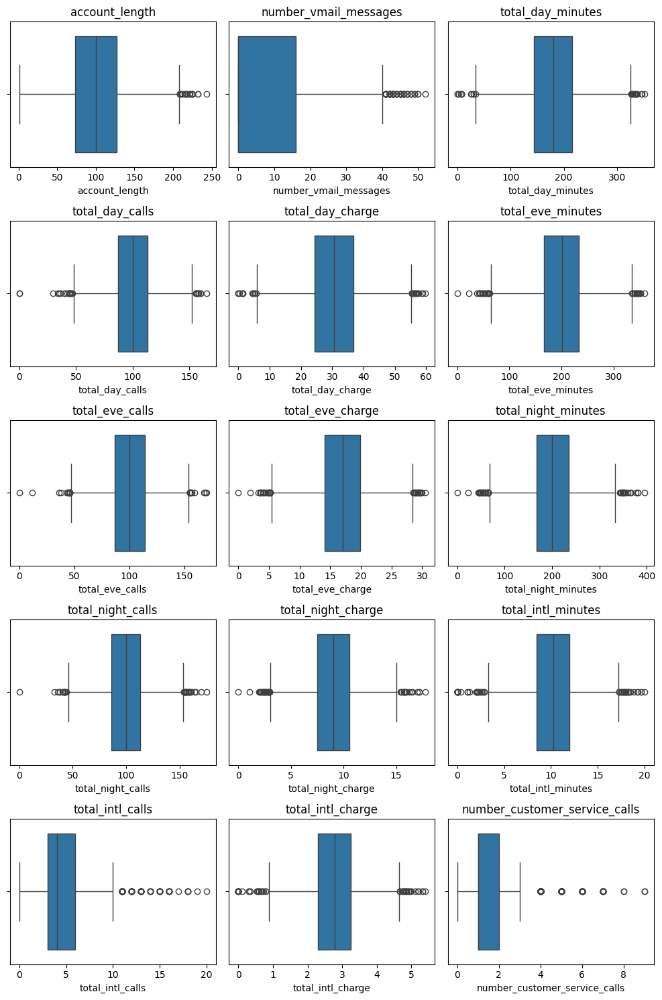

In [ ]:
box_plot(df_train)

Berdasarkan visualisasi di atas terlihat bahwa setiap kolom numerik memiliki outliers.

###**Detect Outlier dengan IQR**

In [ ]:
#detect outlier dengan IQR

def detect_outlier(data, kolom):
  Q1 = data[kolom].quantile(0.25)
  Q3 = data[kolom].quantile(0.75)

  IQR = Q3-Q1

  batas_bawah = Q1 - 1.5 * IQR
  batas_atas = Q3 + 1.5 * IQR

  return data[(data[kolom] < batas_bawah)|(data[kolom] > batas_atas)].shape[0]

In [ ]:
outlier = []

for kolom in kolom_numerik.columns:
  outlier.append(f'{kolom}, jumlah outliers: {detect_outlier(df_train, kolom)}, persentase: {((detect_outlier(df_train, kolom)/len(df_train[kolom]))*100)}')

outlier

['account_length, jumlah outliers: 20, persentase: 0.4705882352941176',
 'number_vmail_messages, jumlah outliers: 86, persentase: 2.023529411764706',
 'total_day_minutes, jumlah outliers: 25, persentase: 0.5882352941176471',
 'total_day_calls, jumlah outliers: 28, persentase: 0.6588235294117647',
 'total_day_charge, jumlah outliers: 26, persentase: 0.611764705882353',
 'total_eve_minutes, jumlah outliers: 34, persentase: 0.8',
 'total_eve_calls, jumlah outliers: 24, persentase: 0.5647058823529412',
 'total_eve_charge, jumlah outliers: 34, persentase: 0.8',
 'total_night_minutes, jumlah outliers: 37, persentase: 0.8705882352941177',
 'total_night_calls, jumlah outliers: 33, persentase: 0.7764705882352941',
 'total_night_charge, jumlah outliers: 37, persentase: 0.8705882352941177',
 'total_intl_minutes, jumlah outliers: 62, persentase: 1.4588235294117646',
 'total_intl_calls, jumlah outliers: 100, persentase: 2.3529411764705883',
 'total_intl_charge, jumlah outliers: 62, persentase: 1.45

###**Detect Outlier dengan Scatter Plot**

In [ ]:
def scatter_plot(pilih):
  # Jumlah kolom dalam satu baris dan jumlah baris yang diinginkan
  kolom_per_baris = 3
  jumlah_kolom = len(kolom_numerik.columns)
  jumlah_baris = (jumlah_kolom + kolom_per_baris - 1) // kolom_per_baris

  # Membuat subplots dengan tata letak grid yang diinginkan
  fig, axes = plt.subplots(nrows=jumlah_baris, ncols=kolom_per_baris, figsize=(12, 8 * jumlah_baris))

  # Menyusun scatter plot ke dalam subplots
  for i, kolom in enumerate(kolom_numerik.columns):
      baris = i // kolom_per_baris
      kolom_di_baris = i % kolom_per_baris
      sns.scatterplot(data=df_train, x=kolom, y=pilih, ax=axes[baris, kolom_di_baris])
      axes[baris, kolom_di_baris].set_title(f'{kolom} vs {pilih}', fontsize=10)

  # Mengatur tata letak dan menampilkan plot
  plt.tight_layout()
  plt.show()

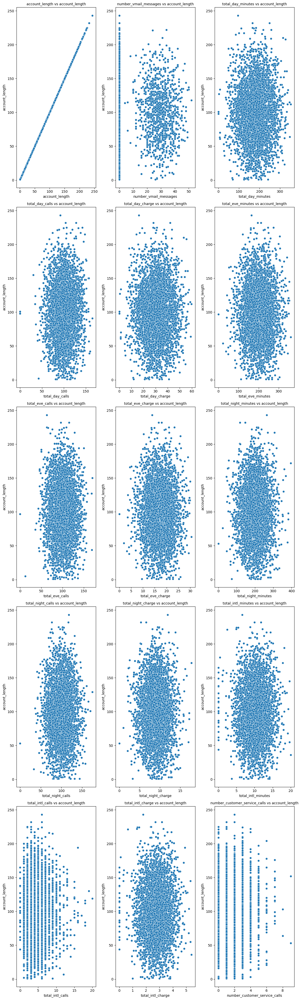

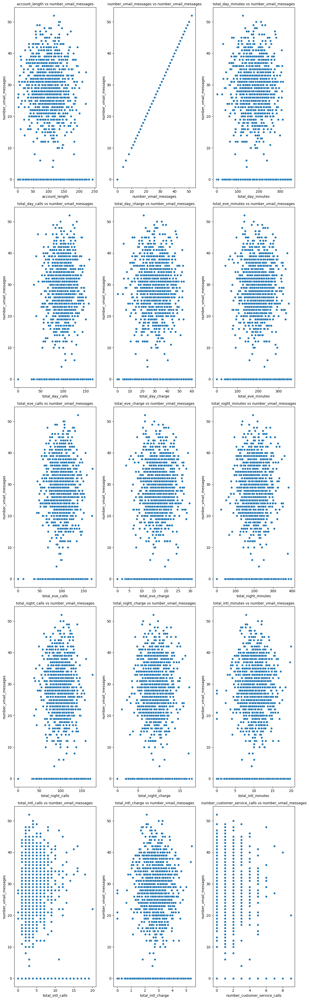

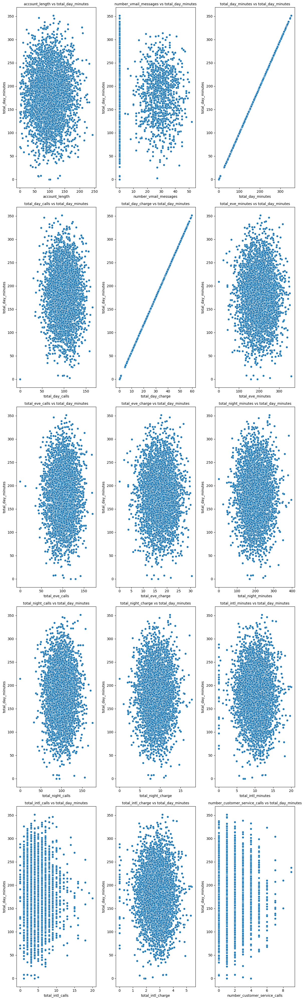

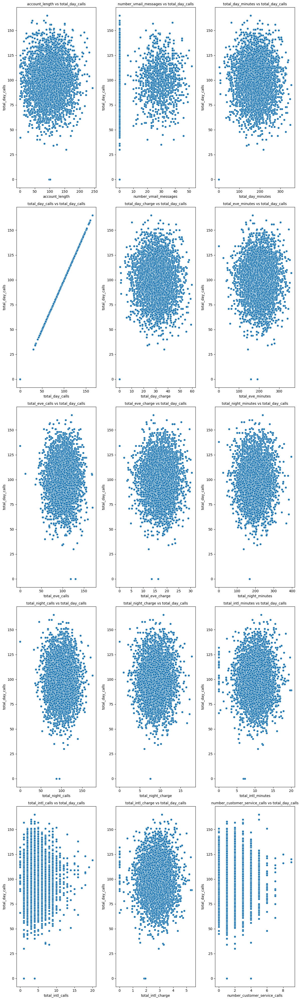

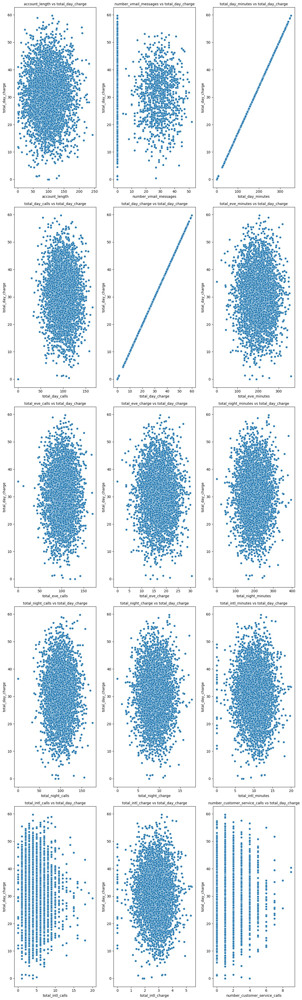

...

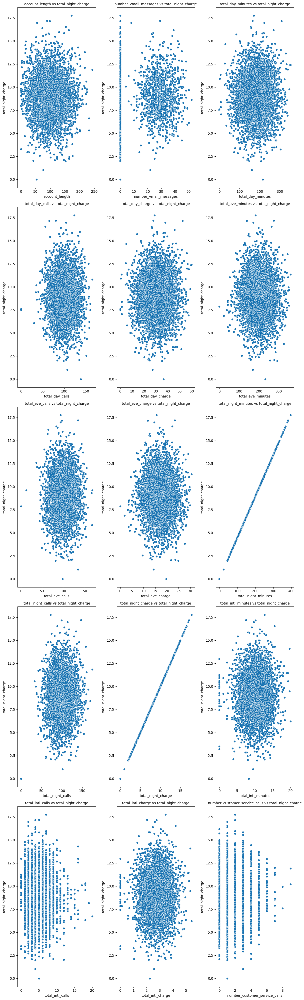

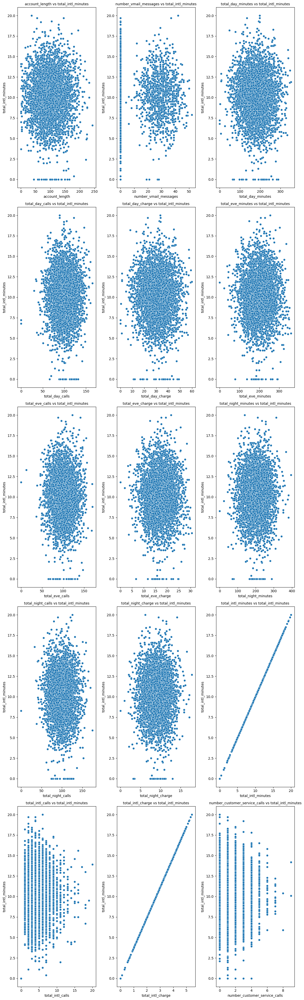

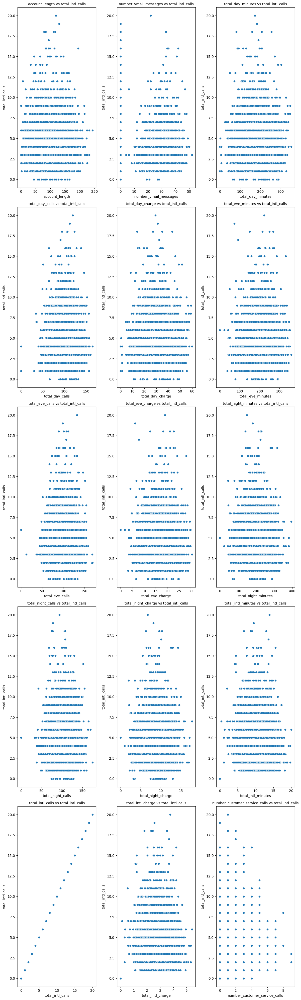

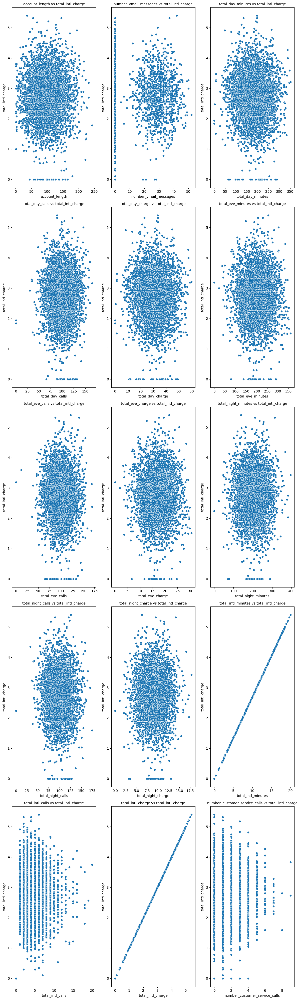

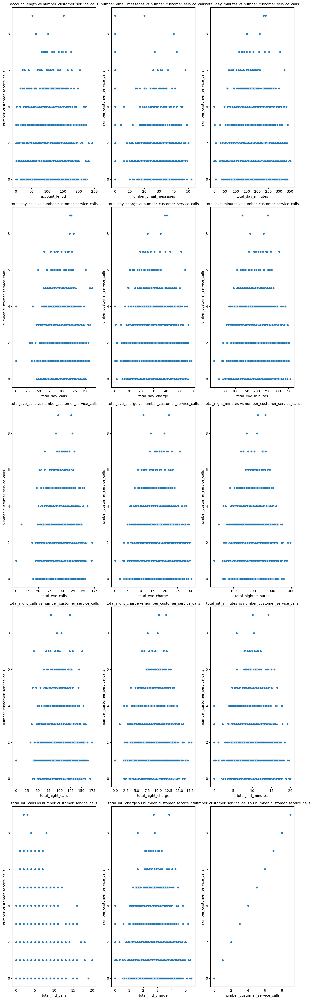

In [ ]:
for i in kolom_numerik.columns:
  scatter_plot(i)

Berdasarkan visualisasi di atas, kita dapat melihat ada banyak outliers yang muncul pada masing-masing kolom pada data.

##**Handling Outliers**

Adanya outliers dapat memberikan hasil analisa menjadi bias dan tidak akurat, oleh karena itu pada tahap selanjutnya akan dilakukan beberapa percobaan handling outlier, dimana pada percobaan yang pertama dilakukan dengan memfilter data hanya dengan data yang berada di rentang batas bawah hingga batas atas (data >= batas_bawah & data <= batas_atas) menggunakan IQR, percobaan yang kedua dilakukan penghapusan outlier, dan yang terakhir mengubah outlier dengan batas atas maupun batas bawah.

###**Filter**

In [ ]:
print(f'Jumlah baris sebelum memfilter outlier: {df_train.shape[0]}')

data_terfilter = np.array([True] * len(df_train))
for kolom in kolom_numerik.columns:
  Q1 = df_train[kolom].quantile(0.25)
  Q3 = df_train[kolom].quantile(0.75)
  IQR = Q3 - Q1
  batas_bawah = Q1 - 1.5 * IQR
  batas_atas = Q3 + 1.5 * IQR
  data_terfilter = ((df_train[kolom] >= batas_bawah) & (df_train[kolom] <= batas_atas)) & data_terfilter
  df_filter = df_train[data_terfilter]
print(f'Jumlah baris setelah memfilter outlier: {df_filter.shape[0]}')

Jumlah baris sebelum memfilter outlier: 4250
Jumlah baris setelah memfilter outlier: 3515


In [ ]:
re_check_outlier = []

for kolom in kolom_numerik.columns:
  re_check_outlier.append(f'{kolom}, jumlah outliers: {detect_outlier(df_filter, kolom)}')

re_check_outlier

['account_length, jumlah outliers: 0',
 'number_vmail_messages, jumlah outliers: 874',
 'total_day_minutes, jumlah outliers: 3',
 'total_day_calls, jumlah outliers: 0',
 'total_day_charge, jumlah outliers: 3',
 'total_eve_minutes, jumlah outliers: 5',
 'total_eve_calls, jumlah outliers: 5',
 'total_eve_charge, jumlah outliers: 5',
 'total_night_minutes, jumlah outliers: 0',
 'total_night_calls, jumlah outliers: 3',
 'total_night_charge, jumlah outliers: 0',
 'total_intl_minutes, jumlah outliers: 5',
 'total_intl_calls, jumlah outliers: 164',
 'total_intl_charge, jumlah outliers: 5',
 'number_customer_service_calls, jumlah outliers: 0']

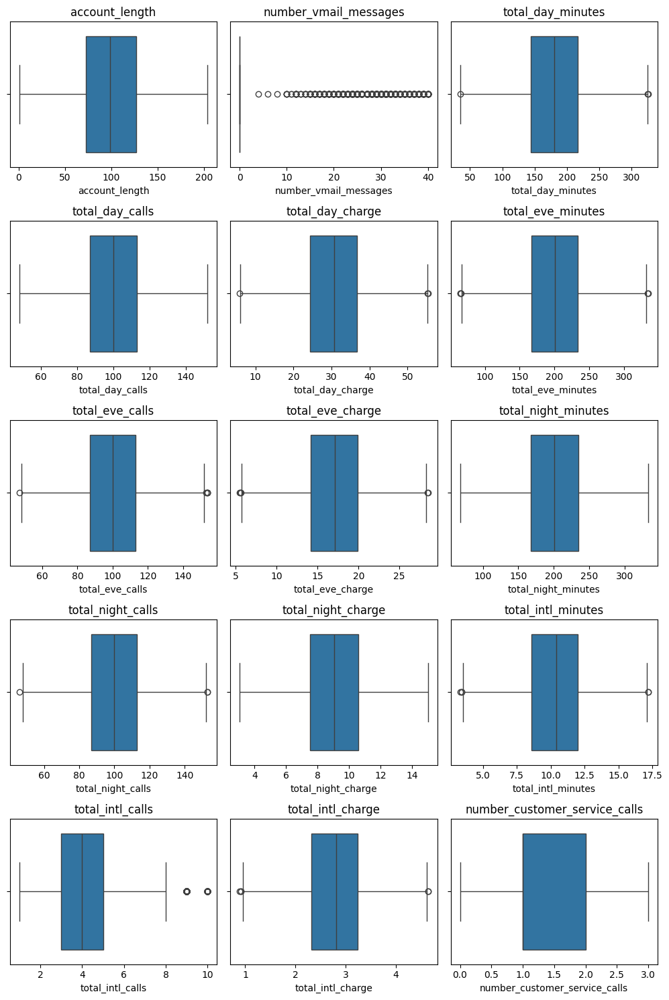

In [ ]:
box_plot(df_filter)

###**Menghapus Outlier**

In [ ]:
df_hapus = df_train.copy()

In [ ]:
def hapus_outlier(data, kolom):
  Q1 = data[kolom].quantile(0.25)
  Q3 = data[kolom].quantile(0.75)
  IQR = Q3-Q1
  batas_bawah = Q1-1.5*IQR
  batas_atas = Q3+1.5*IQR
  data[kolom] = np.where(data[kolom] < batas_bawah, np.nan, data[kolom])
  data[kolom] = np.where(data[kolom] > batas_atas, np.nan, data[kolom])

In [ ]:
for kolom in kolom_numerik.columns:
  hapus_outlier(df_hapus, kolom)

In [ ]:
df_hapus = df_hapus.dropna(axis=0)

In [ ]:
re_check_outlier = []

for kolom in kolom_numerik.columns:
  re_check_outlier.append(f'{kolom}, jumlah outliers: {detect_outlier(df_hapus, kolom)}')

re_check_outlier

['account_length, jumlah outliers: 0',
 'number_vmail_messages, jumlah outliers: 874',
 'total_day_minutes, jumlah outliers: 3',
 'total_day_calls, jumlah outliers: 0',
 'total_day_charge, jumlah outliers: 3',
 'total_eve_minutes, jumlah outliers: 5',
 'total_eve_calls, jumlah outliers: 5',
 'total_eve_charge, jumlah outliers: 5',
 'total_night_minutes, jumlah outliers: 0',
 'total_night_calls, jumlah outliers: 3',
 'total_night_charge, jumlah outliers: 0',
 'total_intl_minutes, jumlah outliers: 5',
 'total_intl_calls, jumlah outliers: 164',
 'total_intl_charge, jumlah outliers: 5',
 'number_customer_service_calls, jumlah outliers: 0']

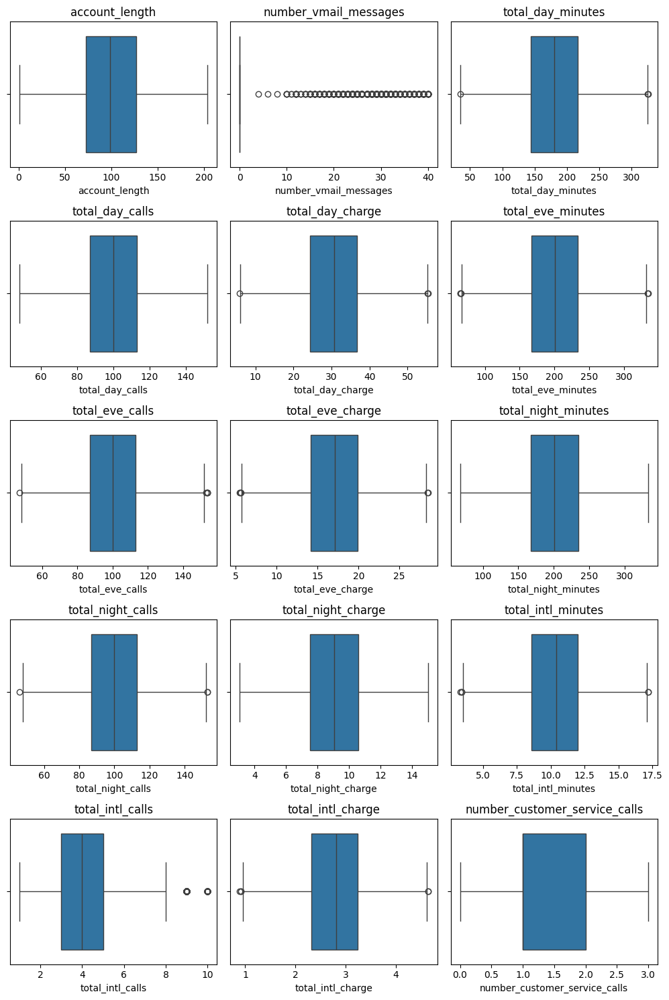

In [ ]:
box_plot(df_hapus)

###**Ubah Outlier**

In [ ]:
df_ubah = df_train.copy()

In [ ]:
def ubah_outlier(kolom):
  Q1 = df_ubah[kolom].quantile(0.25)
  Q3 = df_ubah[kolom].quantile(0.75)
  IQR = Q3-Q1
  batas_bawah = Q1-1.5*IQR
  batas_atas = Q3+1.5*IQR
  df_ubah[kolom] = np.where(df_ubah[kolom] < batas_bawah, batas_bawah, df_ubah[kolom])
  df_ubah[kolom] = np.where(df_ubah[kolom] > batas_atas, batas_atas, df_ubah[kolom])

In [ ]:
for kolom in kolom_numerik.columns:
  ubah_outlier(kolom)

In [ ]:
re_check_outlier = []

for kolom in kolom_numerik.columns:
  re_check_outlier.append(f'{kolom}, jumlah outliers: {detect_outlier(df_ubah, kolom)}')

re_check_outlier

['account_length, jumlah outliers: 0',
 'number_vmail_messages, jumlah outliers: 0',
 'total_day_minutes, jumlah outliers: 0',
 'total_day_calls, jumlah outliers: 0',
 'total_day_charge, jumlah outliers: 0',
 'total_eve_minutes, jumlah outliers: 0',
 'total_eve_calls, jumlah outliers: 0',
 'total_eve_charge, jumlah outliers: 0',
 'total_night_minutes, jumlah outliers: 0',
 'total_night_calls, jumlah outliers: 0',
 'total_night_charge, jumlah outliers: 0',
 'total_intl_minutes, jumlah outliers: 0',
 'total_intl_calls, jumlah outliers: 0',
 'total_intl_charge, jumlah outliers: 0',
 'number_customer_service_calls, jumlah outliers: 0']

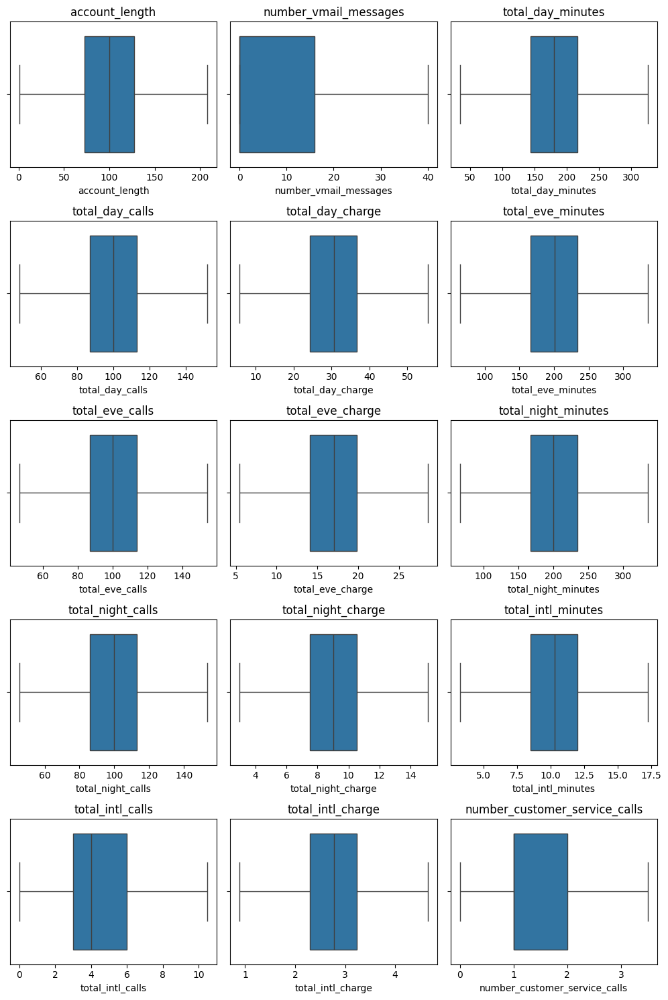

In [ ]:
box_plot(df_ubah)

**Kesimpulan:** berdasarkan percobaan handling outliers yang dilakukan dapat dilihat bahwa percobaan dengan memfilter maupun menghapus outliers tidak benar-benar membersihkan data dari adanya outliers, bahkan di beberapa kolom seperti *number_vmail_messages* dan *total_intl_calls* dimana bukannya outliers berkurang namun malah bertambah. Sedangkan ketika percobaan handling outliers dengan mengubah outliers dengan batas bawah maupun batas atas dapat menghilangkan outliers dari data. Oleh kerena itu pada tahap berikutnya yakni modeling data akan menggunakan data dengan data yang dilakukan percobaan handling outliers dengan mengubah outliers. Sebagai perbandingan, nantinya model akan diuji dengan data ber-outliers dan dengan data tanpa outliers untuk melihat seberapa berpengaruhnya nilai outliers terhadap performa model.

#**EDA**

Pada tahap EDA menggunakan data yang masih terdapat nilai outliers, tujuannya adalah untuk melihat seperti apa insight yang dapat dihasilkan dari data aslinya.

##**1. Berapa total jumlah customer yang churn?**

In [ ]:
customer_churn = df_train['churn'].value_counts()
customer_churn

churn
no     3652
yes     598
Name: count, dtype: int64

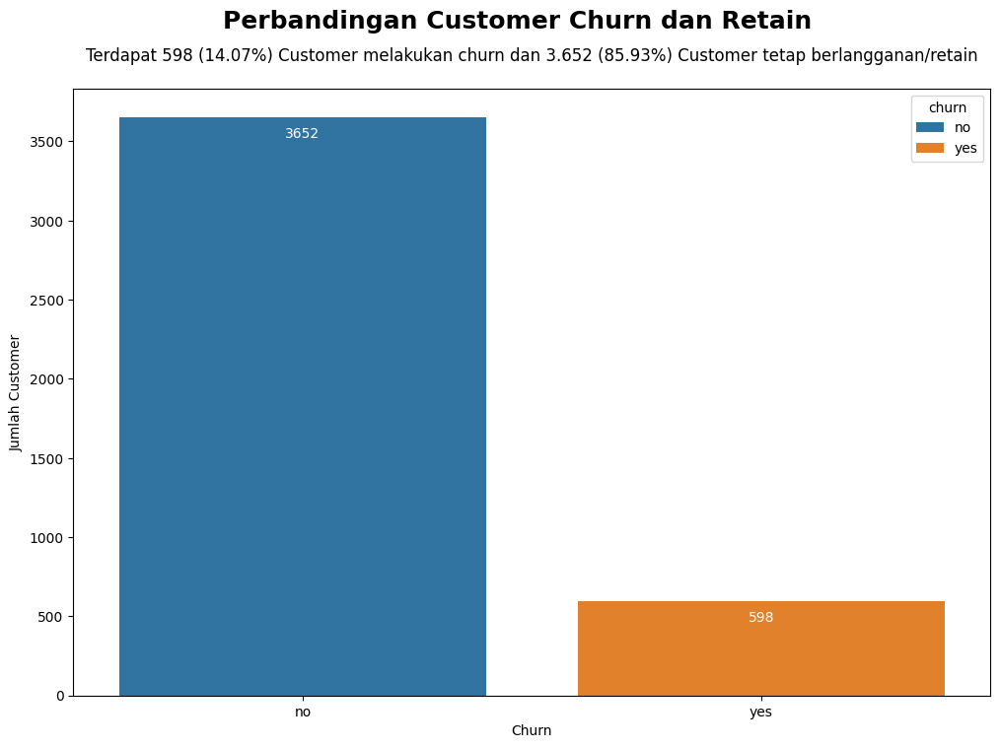

In [ ]:
plt.figure(figsize=(12, 8))
customer_churn_chart = sns.countplot(data=df_train, x='churn', hue='churn', legend=True)
plt.suptitle('Perbandingan Customer Churn dan Retain', fontsize=18, ha='center', color='black', weight='bold')
plt.title('Terdapat 598 (14.07%) Customer melakukan churn dan 3.652 (85.93%) Customer tetap berlangganan/retain', pad = '20', ha='center', fontsize=12)
customer_churn_chart.set_xlabel('Churn')
customer_churn_chart.set_ylabel('Jumlah Customer')
for p in customer_churn_chart.patches:
    if p.get_height() != 0:
        customer_churn_chart.annotate(format(p.get_height(), '.0f'),
                             (p.get_x() + p.get_width() / 2., p.get_height()),
                             ha = 'center', va = 'center', color = 'white',
                             xytext = (0, -12),
                             textcoords = 'offset points')
plt.show()

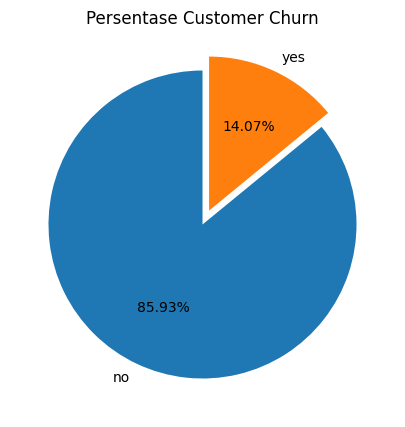

In [ ]:
plt.figure(figsize=(10,5))
plt.pie(customer_churn, labels=customer_churn.index, autopct='%1.2f%%', startangle=90, explode=[0, 0.1])
plt.title('Persentase Customer Churn')
plt.show()

**Insight:** dari total 4.250 customer terdapat lebih dari 14% (598) customer melakukan churn atau berhenti berlangganan.

##**2. Negara bagian mana yang memiliki jumlah customer terbanyak?**

In [ ]:
state_customer = df_train.groupby(['state'])['churn'].count().sort_values(ascending=False).reset_index(name='jumlah_customer')
state_customer

,state,jumlah_customer
0,WV,139
1,MN,108
2,ID,106
3,AL,101
4,VA,100
5,OR,99
6,TX,98
7,UT,97
8,NJ,96
9,NY,96


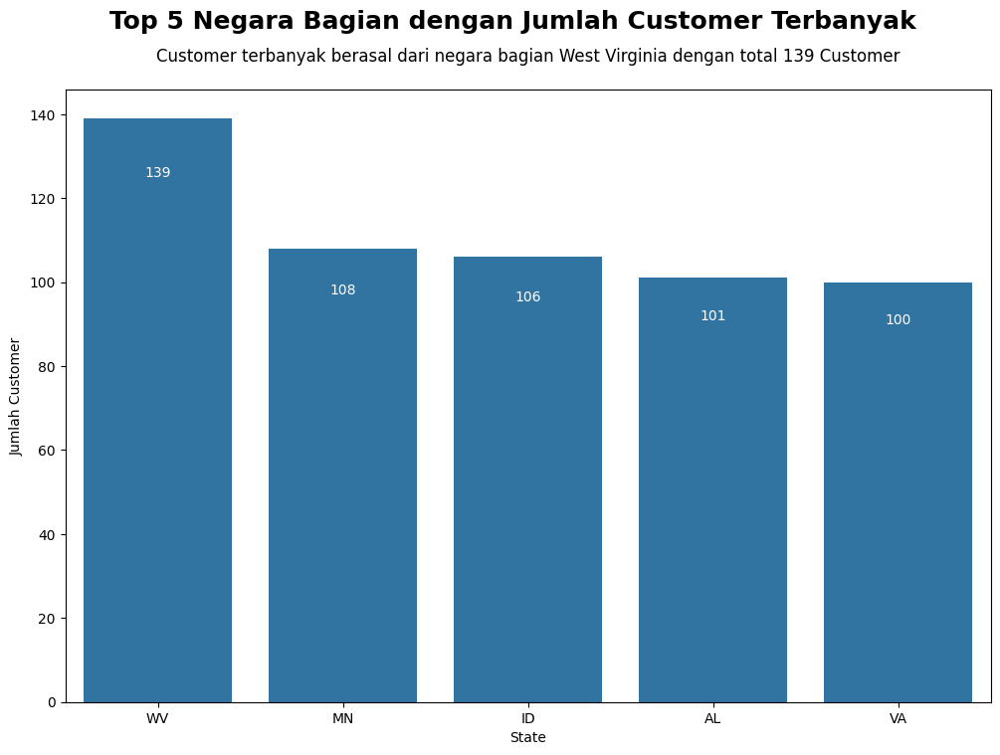

In [ ]:
plt.figure(figsize=(12,8))
state_customer_chart = sns.barplot(data=state_customer.head(), x='state', y='jumlah_customer')
plt.suptitle('Top 5 Negara Bagian dengan Jumlah Customer Terbanyak', fontsize=18, ha='center', color='black', weight='bold')
plt.title('Customer terbanyak berasal dari negara bagian West Virginia dengan total 139 Customer', pad = '20', ha='center', fontsize=12)
state_customer_chart.set_xlabel('State')
state_customer_chart.set_ylabel('Jumlah Customer')
for index, row in state_customer.head().iterrows():
    state_customer_chart.text(index, row['jumlah_customer'] - 0.10 * row['jumlah_customer'], str(row['jumlah_customer']), color='white', ha="center")
plt.show()

**Insight**: negara bagian West Virginia merupakan negara bagian dengan jumlah customer terbanyak/jumlah customer terbanyak berasal dari negara bagian West Virginia dengan total jumlah 139 customer.

##**3. Jumlah customer churn terbanyak berasal dari negara bagian mana?**

In [ ]:
state_churn = df_train[df_train['churn']=='yes'].groupby(['state'])['churn'].count().sort_values(ascending=False).reset_index()
state_churn

,state,churn
0,NJ,26
1,TX,19
2,MN,19
3,WV,19
4,MD,19
5,WA,18
6,NV,17
7,MT,17
8,ME,16
9,OK,16


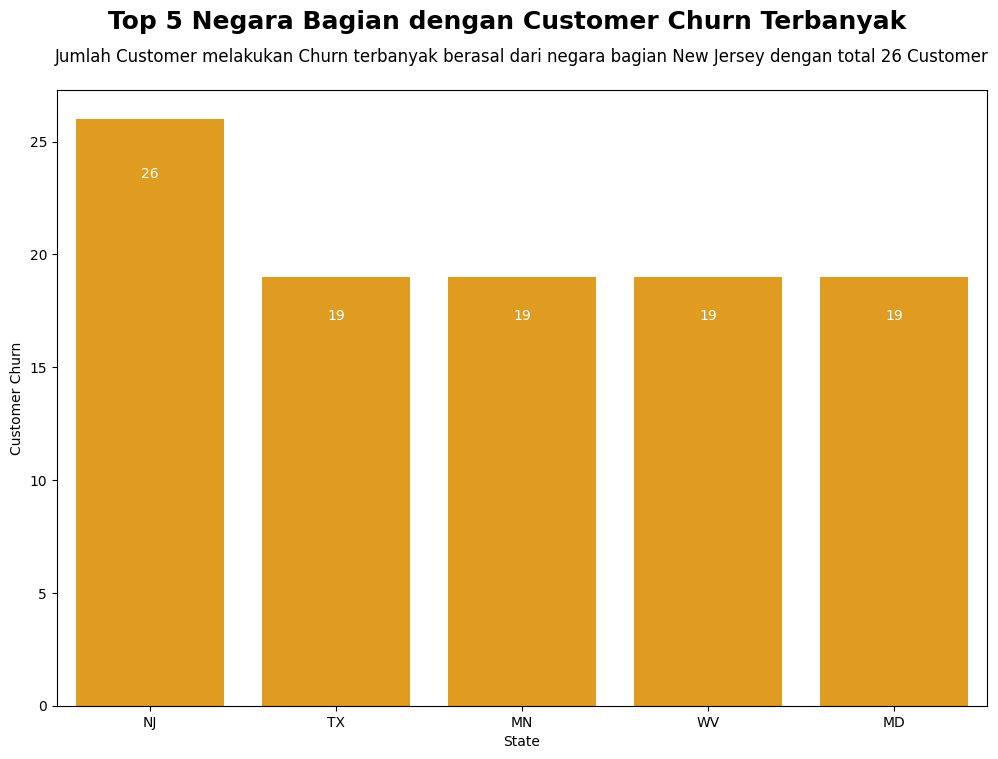

In [ ]:
plt.figure(figsize=(12, 8))
state_churn_chart = sns.barplot(data=state_churn.head(), x='state', y='churn', color='orange')
plt.suptitle('Top 5 Negara Bagian dengan Customer Churn Terbanyak', fontsize=18, ha='center', color='black', weight='bold')
plt.title('Jumlah Customer melakukan Churn terbanyak berasal dari negara bagian New Jersey dengan total 26 Customer', pad = '20', ha='center', fontsize=12)
state_churn_chart.set_xlabel('State')
state_churn_chart.set_ylabel('Customer Churn')
for index, row in state_churn.head().iterrows():
    state_churn_chart.text(index, row['churn'] - 0.10 * row['churn'], str(row['churn']), color='white', ha="center")
plt.show()

**Insight**: negara bagian New Jersey merupakan negara bagian dengan jumlah customer churn (berhenti berlangganan) terbanyak/Jumlah customer churn terbanyak berasal dari negara bagian New Jersey dengan jumlah total 26 customer.

##**4. Negara bagian mana yang memiliki tingkat churn tertinggi?**

In [ ]:
customer_all = state_customer
customer_churn = state_churn
churn_rate = customer_all.merge(customer_churn, on='state')
churn_rate['churn_rate'] = (churn_rate['churn']/churn_rate['jumlah_customer'])*100
churn_rate['churn_rate'] = churn_rate['churn_rate'].round(2)
churn_rate = churn_rate.sort_values(by='churn_rate', ascending=False).reset_index(drop=True)
churn_rate

,state,jumlah_customer,churn,churn_rate
0,NJ,96,26,27.08
1,CA,39,10,25.64
2,WA,80,18,22.50
3,MD,86,19,22.09
4,MT,80,17,21.25
5,OK,78,16,20.51
6,NV,83,17,20.48
7,SC,72,14,19.44
8,TX,98,19,19.39
9,MS,82,15,18.29


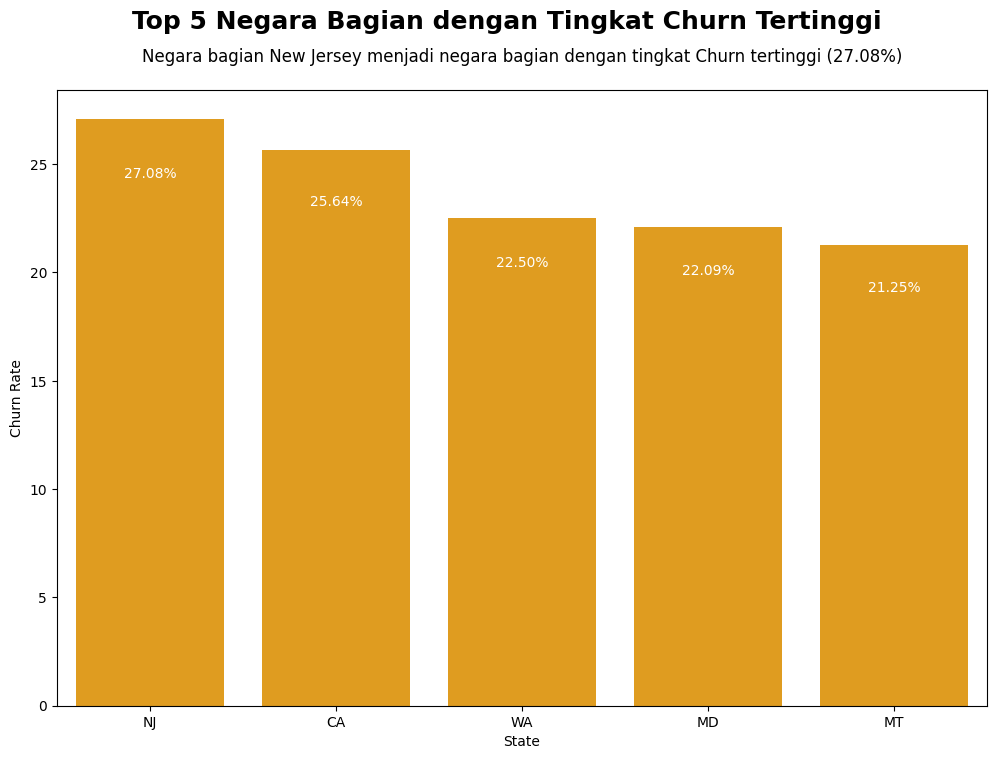

In [ ]:
plt.figure(figsize=(12, 8))
churn_rate_chart = sns.barplot(data=churn_rate.head(), x='state', y='churn_rate', color='orange')
plt.suptitle('Top 5 Negara Bagian dengan Tingkat Churn Tertinggi', fontsize=18, ha='center', color='black', weight='bold')
plt.title('Negara bagian New Jersey menjadi negara bagian dengan tingkat Churn tertinggi (27.08%)', pad = '20', ha='center', fontsize=12)
churn_rate_chart.set_xlabel('State')
churn_rate_chart.set_ylabel('Churn Rate')
for index, row in churn_rate.head().iterrows():
    churn_rate_chart.text(index, row['churn_rate'] - 0.10 * row['churn_rate'], str(f'{row.churn_rate:.2f}') + '%', color='white', ha="center")
plt.show()

**Insight**: negara bagian New Jersey selain menjadi negara bagian dengan jumlah customer churn terbanyak juga menjadi negara bagian dengan tingkat churn tertinggi.

##**5. Negara bagian mana yang memiliki jumlah customer retain terbanyak?**

In [ ]:
state_retain = df_train[df_train['churn']=='no'].groupby(['state'])['churn'].count().sort_values(ascending=False).reset_index(name='retain')
state_retain

,state,retain
0,WV,120
1,VA,95
2,ID,94
3,MN,89
4,AL,88
5,WI,87
6,WY,85
7,UT,85
8,OR,84
9,OH,83


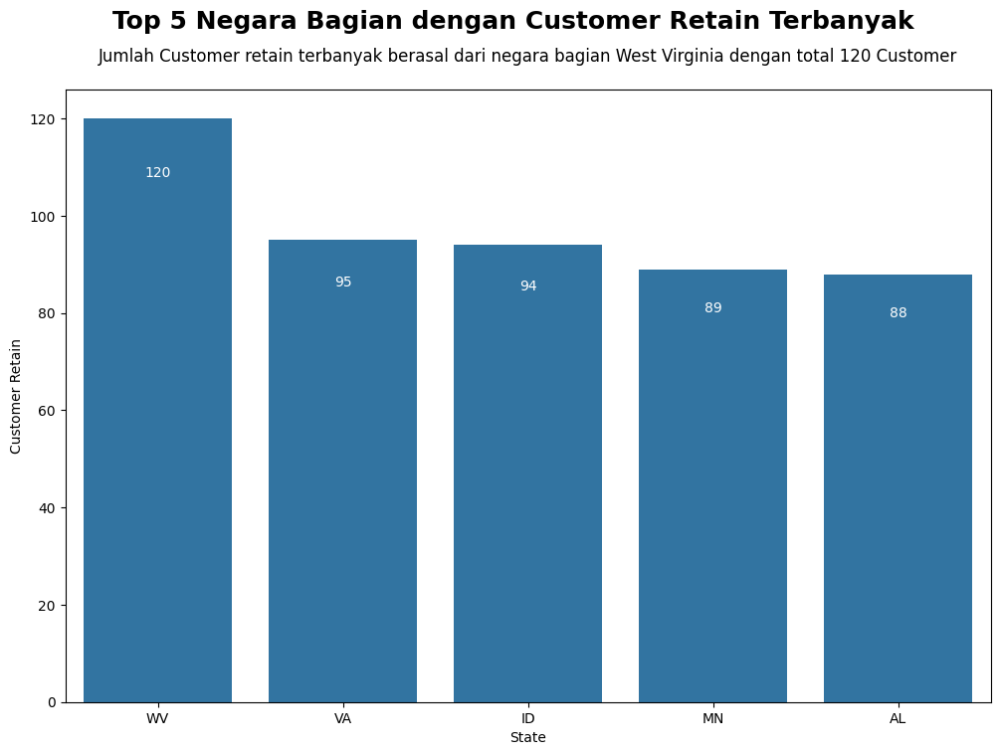

In [ ]:
plt.figure(figsize=(12, 8))
state_chart = sns.barplot(data=state_retain.head(), x='state', y='retain')
plt.suptitle('Top 5 Negara Bagian dengan Customer Retain Terbanyak', fontsize=18, ha='center', color='black', weight='bold')
plt.title('Jumlah Customer retain terbanyak berasal dari negara bagian West Virginia dengan total 120 Customer', pad = '20', ha='center', fontsize=12)
state_chart.set_xlabel('State')
state_chart.set_ylabel('Customer Retain')
for index, row in state_retain.head().iterrows():
    state_chart.text(index, row['retain'] - 0.10 * row['retain'], str(row['retain']), color='white', ha="center")
plt.show()

**Insight**: negara bagian West Virginia merupakan negara bagian dengan jumlah customer retain (masih bertahan untuk berlangganan) terbanyak/Jumlah customer retain terbanyak berasal dari negara bagian West Virginia.

##**6. Berapa jumlah customer yang berlangganan paket internasional?**

In [ ]:
customer_int_plan = df_train.groupby(['international_plan'])['churn'].count().reset_index(name='jumlah_customer')
customer_int_plan

,international_plan,jumlah_customer
0,no,3854
1,yes,396


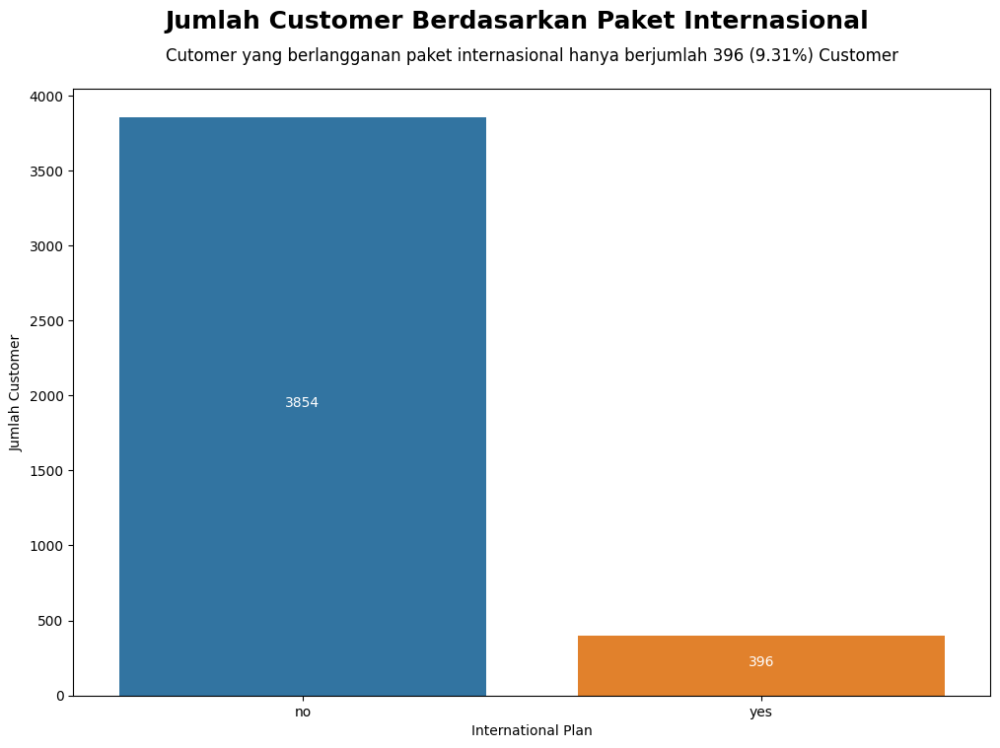

In [ ]:
plt.figure(figsize=(12,8))
customer_int_plan_chart = sns.barplot(data=customer_int_plan, hue='international_plan', x='international_plan', y='jumlah_customer')
plt.suptitle('Jumlah Customer Berdasarkan Paket Internasional', fontsize=18, ha='center', color='black', weight='bold')
plt.title('Cutomer yang berlangganan paket internasional hanya berjumlah 396 (9.31%) Customer', pad = '20', ha='center', fontsize=12)
customer_int_plan_chart.set_xlabel('International Plan')
customer_int_plan_chart.set_ylabel('Jumlah Customer')
for index, row in customer_int_plan.iterrows():
    customer_int_plan_chart.text(index, row['jumlah_customer']/2, str(row['jumlah_customer']), color='white', ha="center")
plt.show()

**Insight**: customer yang berlangganan paket internasional hanya sebanyak 396 (9.31%) customer.

##**7. Apakah berlangganan paket internasional berpengaruh terhadap customer churn?**

In [ ]:
churn_international_plan = df_train.groupby(['international_plan', 'churn'])['churn'].count().reset_index(name='jumlah_customer')
churn_international_plan

,international_plan,churn,jumlah_customer
0,no,no,3423
1,no,yes,431
2,yes,no,229
3,yes,yes,167


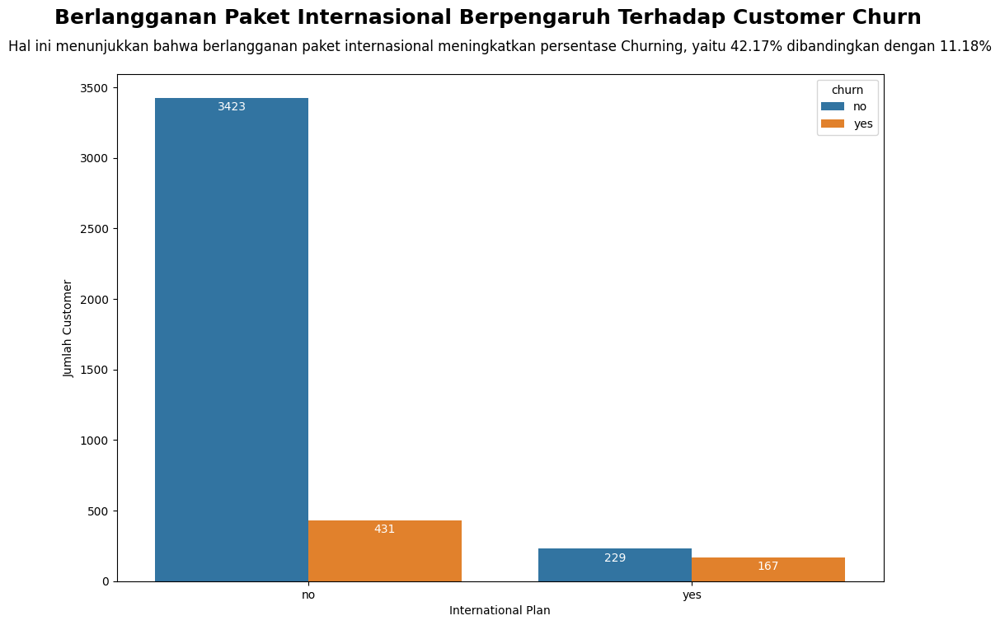

In [ ]:
plt.figure(figsize=(12,8))
churn_international_plan_chart = sns.barplot(data=churn_international_plan, x='international_plan', y='jumlah_customer', hue='churn')
plt.suptitle('Berlangganan Paket Internasional Berpengaruh Terhadap Customer Churn', fontsize=18, ha='center', color='black', weight='bold')
plt.title('Hal ini menunjukkan bahwa berlangganan paket internasional meningkatkan persentase Churning, yaitu 42.17% dibandingkan dengan 11.18%', pad = '20', ha='center', fontsize=12)
churn_international_plan_chart.set_xlabel('International Plan')
churn_international_plan_chart.set_ylabel('Jumlah Customer')
for p in churn_international_plan_chart.patches:
    if p.get_height() != 0:
        churn_international_plan_chart.annotate(format(p.get_height(), '.0f'),
                             (p.get_x() + p.get_width() / 2., p.get_height()),
                             ha = 'center', va = 'center', color = 'white',
                             xytext = (0, -8),
                             textcoords = 'offset points')
plt.show()

**Insight**: walaupun jumlah customer churn pada customer yang tidak berlangganan paket internasional mencapai 431 customer, namun ditemukan bahwa persentase customer churn lebih tinggi pada customer yang berlangganan paket internasional. Dengan demikian dapat disimpulkan bahwa berlangganan paket internasional dapat mempengaruhi customer churn.

##**8. Berapa jumlah customer yang berlangganan paket voice mail?**

In [ ]:
customer_voice_mail_plan = df_train.groupby(['voice_mail_plan'])['churn'].count().reset_index(name='jumlah_customer')
customer_voice_mail_plan

,voice_mail_plan,jumlah_customer
0,no,3138
1,yes,1112


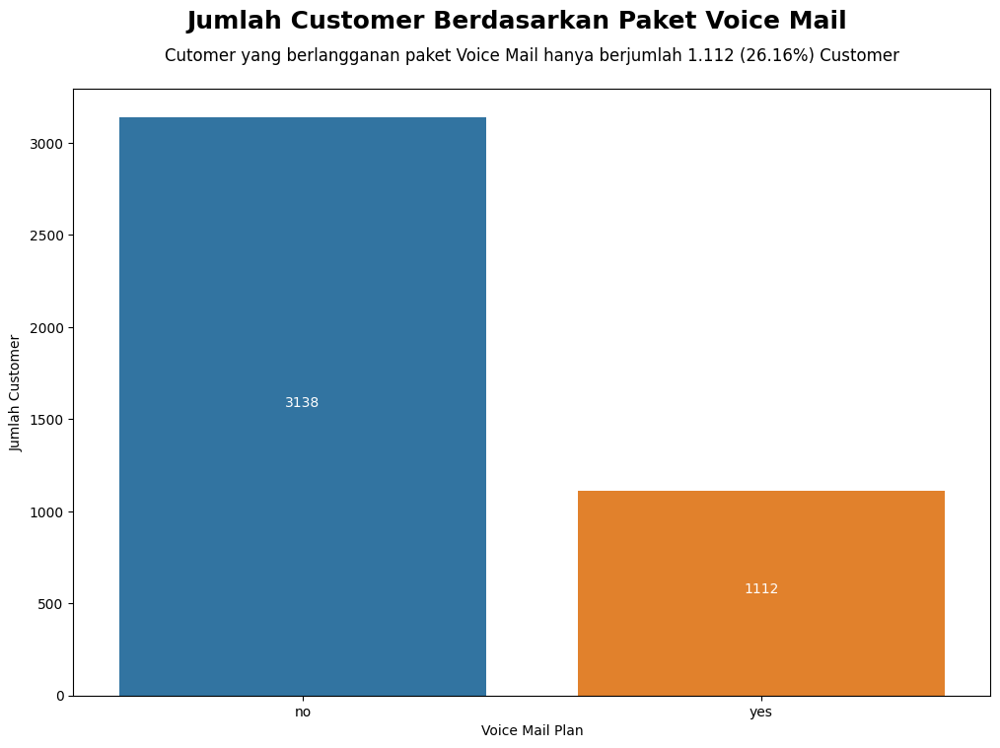

In [ ]:
plt.figure(figsize=(12,8))
customer_voice_mail_plan_chart = sns.barplot(data=customer_voice_mail_plan, hue='voice_mail_plan', x='voice_mail_plan', y='jumlah_customer')
plt.suptitle('Jumlah Customer Berdasarkan Paket Voice Mail', fontsize=18, ha='center', color='black', weight='bold')
plt.title('Cutomer yang berlangganan paket Voice Mail hanya berjumlah 1.112 (26.16%) Customer', pad = '20', ha='center', fontsize=12)
customer_voice_mail_plan_chart.set_xlabel('Voice Mail Plan')
customer_voice_mail_plan_chart.set_ylabel('Jumlah Customer')
for index, row in customer_voice_mail_plan.iterrows():
    customer_voice_mail_plan_chart.text(index, row['jumlah_customer']/2, str(row['jumlah_customer']), color='white', ha="center")
plt.show()

**Insight**: customer yang berlangganan paket voice mail hanya sebanyak 1.112 (26.16%) customer.

##**9. Apakah berlangganan paket voice mail berpengaruh terhadap customer churn?**

In [ ]:
churn_voice_mail_plan = df_train.groupby(['voice_mail_plan', 'churn'])['churn'].count().reset_index(name='jumlah_customer')
churn_voice_mail_plan

,voice_mail_plan,churn,jumlah_customer
0,no,no,2622
1,no,yes,516
2,yes,no,1030
3,yes,yes,82


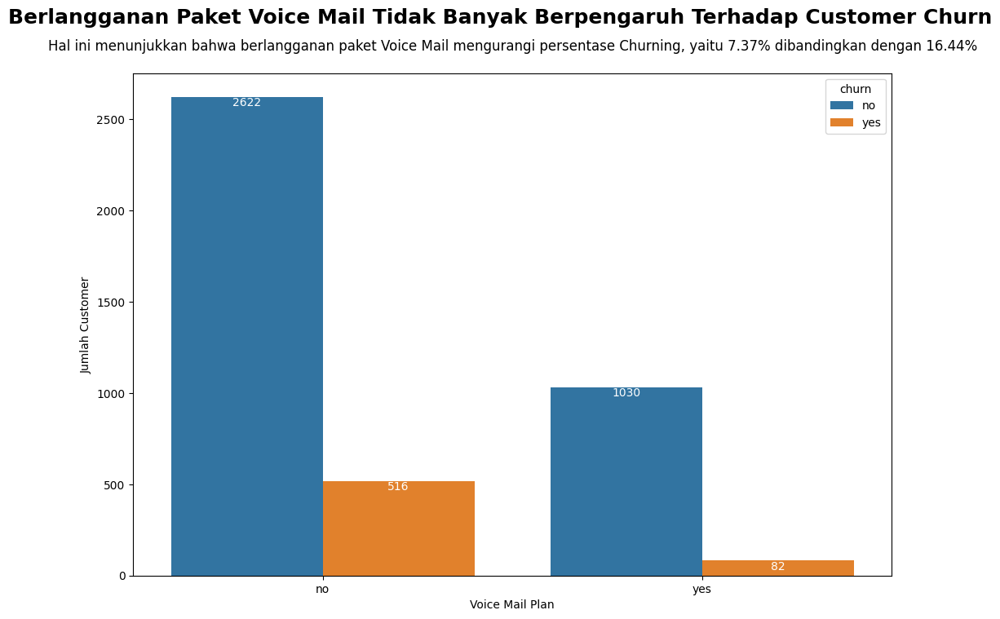

In [ ]:
plt.figure(figsize=(12,8))
churn_voice_mail_plan_chart = sns.barplot(data=churn_voice_mail_plan, x='voice_mail_plan', y='jumlah_customer', hue='churn')
plt.suptitle('Berlangganan Paket Voice Mail Tidak Banyak Berpengaruh Terhadap Customer Churn', fontsize=18, ha='center', color='black', weight='bold')
plt.title('Hal ini menunjukkan bahwa berlangganan paket Voice Mail mengurangi persentase Churning, yaitu 7.37% dibandingkan dengan 16.44%', pad = '20', ha='center', fontsize=12)
churn_voice_mail_plan_chart.set_xlabel('Voice Mail Plan')
churn_voice_mail_plan_chart.set_ylabel('Jumlah Customer')
for p in churn_voice_mail_plan_chart.patches:
    if p.get_height() != 0:
        churn_voice_mail_plan_chart.annotate(format(p.get_height(), '.0f'),
                             (p.get_x() + p.get_width() / 2., p.get_height()),
                             ha = 'center', va = 'center', color = 'white',
                             xytext = (0, -5),
                             textcoords = 'offset points')
plt.show()

**Insight**: walaupun customer retain banyak ditemukan pada customer yang tidak berlangganan paket voice mail, namun customer yang tidak berlangganan paket voice mail lebih banyak melakukan churn daripada customer yang berlangganan paket voice mail. Oleh karena itu dapat disimpulkan bahwa berlangganan paket voice mail cenderung tidak mempengaruhi customer churn.

##**10. Apakah jumlah panggilan ke customer service berpengaruh pada customer churn?**

In [ ]:
cs_call_freq = pd.crosstab(df_train['number_customer_service_calls'], df_train['churn']).reset_index()
cs_call_freq['churn_rate'] = (cs_call_freq['yes']/(cs_call_freq['yes'] + cs_call_freq['no'])*100).round(2)
cs_call_freq.columns = ['number_customer_service_calls', 'churn_no', 'churn_yes', 'churn_rate']
cs_call_freq

,number_customer_service_calls,churn_no,churn_yes,churn_rate
0,0,789,97,10.95
1,1,1358,166,10.89
2,2,845,102,10.77
3,3,495,63,11.29
4,4,117,92,44.02
5,5,32,49,60.49
6,6,9,19,67.86
7,7,6,7,53.85
8,8,1,1,50.00
9,9,0,2,100.00


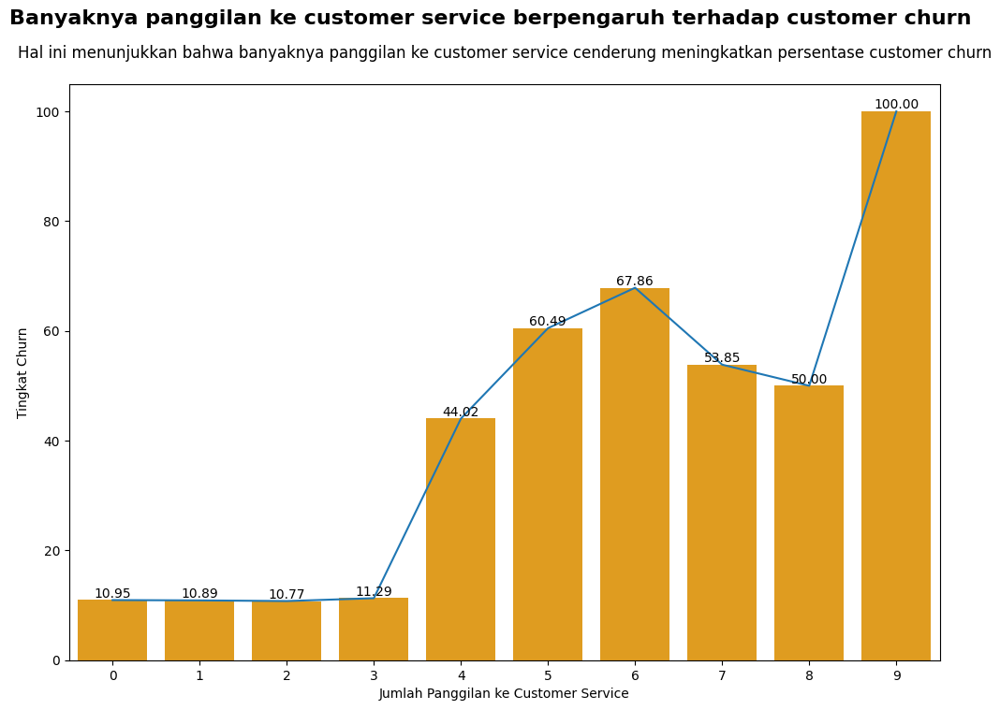

In [ ]:
fig, ax1 = plt.subplots(figsize=(12, 8))

# Line chart
cs_call_freq_chart = sns.lineplot(data=cs_call_freq, x='number_customer_service_calls', y='churn_rate', ax=ax1)

# Bar chart
sns.barplot(data=cs_call_freq, x='number_customer_service_calls', y='churn_rate', ax=ax1, color='orange')
ax1.set_ylabel('Tingkat Churn')
ax1.set_xlabel('Jumlah Panggilan ke Customer Service')

# Annotate bar chart
for p in ax1.patches:
    height = p.get_height()
    ax1.annotate(format(height, '.2f'),
                 (p.get_x() + p.get_width() / 2., height),
                 ha='center', va='center', color='black', fontsize=10,
                 xytext=(0, 5), textcoords='offset points')

plt.suptitle('Banyaknya panggilan ke customer service berpengaruh terhadap customer churn', fontsize='16', ha='center', color='black', weight='bold')
plt.title('Hal ini menunjukkan bahwa banyaknya panggilan ke customer service cenderung meningkatkan persentase customer churn', pad='20', ha='center', fontsize=12)

plt.show()

**Insight:** banyaknya jumlah panggilan ke customer service berpengaruh terhadap customer churn, hal ini terlihat ketika panggilan berjumlah di atas 3 kali terjadi peningkatan tingkat churn yang signifikan dan seiring bertambahnya jumlah panggilan seterusnya, tingkat churn relatif meningkat.

##**11. Apakah beban/biaya yang dikeluarkan customer berpengaruh pada customer churn?**

In [ ]:
def viz_boxhistplot(data, target_column, feature_column):
    """
    Data = dataframe
    Target_column = Churn (kolom tujuan)
    Feature_column = kolom lain yang ingin dilihat hubungannya dengan Churn
    """

    fig, (ax_box, ax_hist) = plt.subplots(2, sharex = True, gridspec_kw = {'height_ratios':(.2, .8)})
    boxplot = sns.boxplot(data = data, x = feature_column, ax = ax_box, y = target_column, hue = 'churn')
    histplot = sns.histplot(data = data, x = feature_column, ax = ax_hist, hue = target_column)

    ax_box.set(xlabel = '')
    ax_hist.set(ylabel = 'Histogram')
    ax_hist.set_xlabel(feature_column)
    plt.suptitle(f'{feature_column} and {target_column}: Boxplot and Histogram')
    plt.show()

####**Total Day Charge (total biaya yang dibebankan kepada customer untuk panggilan siang hari (06.00 - 18.00))**

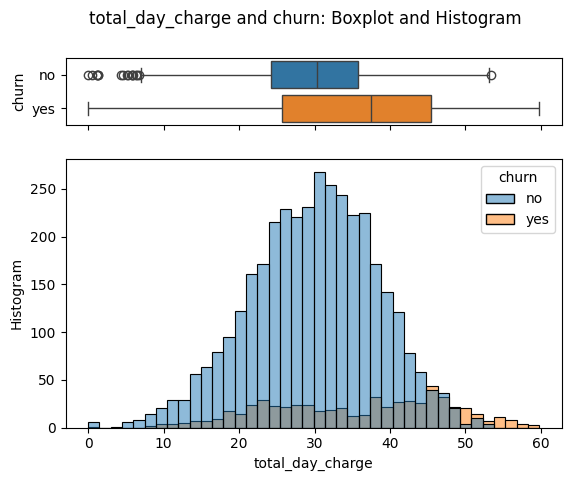

In [ ]:
viz_boxhistplot(data=df_train, target_column='churn', feature_column='total_day_charge')

In [ ]:
print("Rata-rata total biaya panggilan siang hari untuk customer yang churn adalah: {}".format(df_train[df_train['churn'] == 'yes']["total_day_charge"].mean()))
print(f"Rata-rata total biaya panggilan siang hari untuk customer yang retain adalah: {df_train[df_train['churn'] == 'no'].total_day_charge.mean()} ")

Rata-rata total biaya panggilan siang hari untuk customer yang churn adalah: 35.52867892976589
Rata-rata total biaya panggilan siang hari untuk customer yang retain adalah: 29.844947973713033 


####**Total Eve Charge (total biaya yang dibebankan kepada customer untuk panggilan malam hari (18.00 - 22.00))**

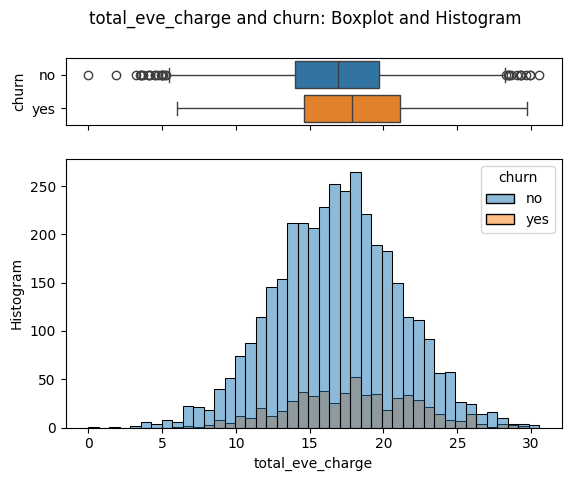

In [ ]:
viz_boxhistplot(data=df_train, target_column='churn', feature_column='total_eve_charge')

In [ ]:
print("Rata-rata total biaya panggilan malam hari untuk customer yang churn adalah: {}".format(df_train[df_train['churn'] == 'yes']["total_eve_charge"].mean()))
print(f"Rata-rata total biaya panggilan malam hari untuk customer yang retain adalah: {df_train[df_train['churn'] == 'no'].total_eve_charge.mean()} ")

Rata-rata total biaya panggilan malam hari untuk customer yang churn adalah: 17.847207357859535
Rata-rata total biaya panggilan malam hari untuk customer yang retain adalah: 16.878743154435924 


####**Total Night Charge (total biaya yang dibebankan kepada customer untuk panggilan malam hari (22.00 - 06.00))**

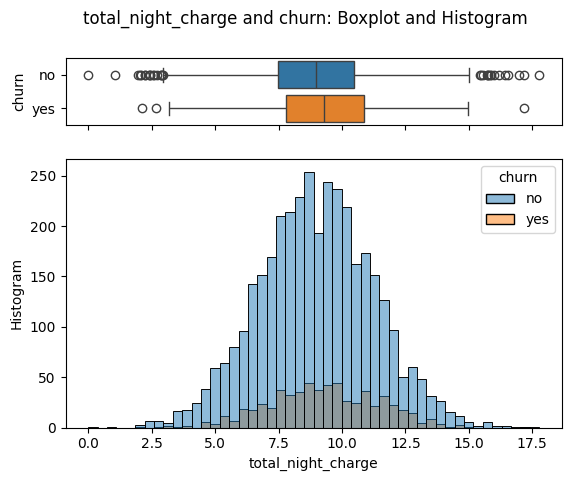

In [ ]:
viz_boxhistplot(data=df_train, target_column='churn', feature_column='total_night_charge')

In [ ]:
print("Rata-rata total biaya panggilan malam hari untuk customer yang churn adalah: {}".format(df_train[df_train['churn'] == 'yes']["total_night_charge"].mean()))
print(f"Rata-rata total biaya panggilan malam hari untuk customer yang retain adalah: {df_train[df_train['churn'] == 'no'].total_night_charge.mean()} ")

Rata-rata total biaya panggilan malam hari untuk customer yang churn adalah: 9.285033444816053
Rata-rata total biaya panggilan malam hari untuk customer yang retain adalah: 8.981130887185103 


####**Total International Charge (total biaya yang dibebankan kepada customer untuk paket panggilan internasional)**

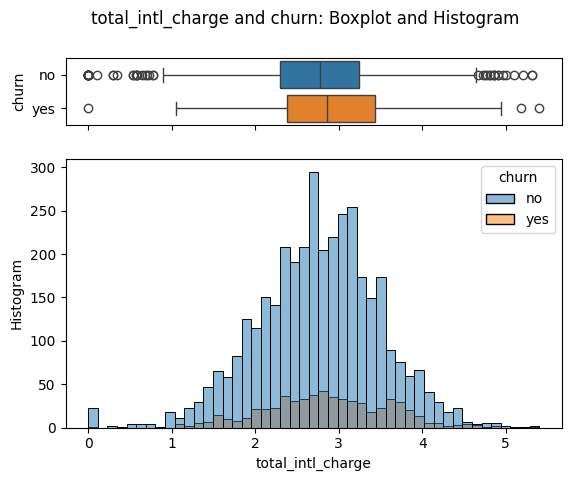

In [ ]:
viz_boxhistplot(data=df_train, target_column='churn', feature_column='total_intl_charge')

In [ ]:
print("Rata-rata total biaya paket panggilan internasional untuk customer yang churn adalah: {}".format(df_train[df_train['churn'] == 'yes']["total_intl_charge"].mean()))
print(f"Rata-rata total biaya paket panggilan internasional untuk customer yang retain adalah: {df_train[df_train['churn'] == 'no'].total_intl_charge.mean()} ")

Rata-rata total biaya paket panggilan internasional untuk customer yang churn adalah: 2.8712541806020067
Rata-rata total biaya paket panggilan internasional untuk customer yang retain adalah: 2.7530175246440303 


**Insight**: semakin besar biaya panggilan yang dibebankan ke customer maka semakin berpotensi customer dapat melakukan churn.

##**Korelasi**

In [ ]:
corr = kolom_numerik.corr(method='pearson')
corr

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
account_length,1.000000,-0.006626,-0.001612,0.023002,-0.001613,-0.010326,0.005535,-0.010322,-0.009916,-0.001846,-0.009942,0.004539,0.013690,0.004494,0.001002
number_vmail_messages,-0.006626,1.000000,0.002000,-0.006920,0.001994,0.010725,0.003593,0.010736,0.018308,0.001977,0.018300,0.005220,0.006585,0.005249,-0.015303
total_day_minutes,-0.001612,0.002000,1.000000,0.000747,1.000000,-0.013248,0.005986,-0.013258,0.010049,-0.004812,0.010036,-0.021369,0.003859,-0.021291,-0.002925
total_day_calls,0.023002,-0.006920,0.000747,1.000000,0.000751,0.008661,0.003739,0.008663,0.002206,-0.004815,0.002200,0.008834,0.009377,0.008909,-0.015845
total_day_charge,-0.001613,0.001994,1.000000,0.000751,1.000000,-0.013247,0.005985,-0.013257,0.010053,-0.004816,0.010040,-0.021374,0.003853,-0.021296,-0.002932
total_eve_minutes,-0.010326,0.010725,-0.013248,0.008661,-0.013247,1.000000,0.003101,1.000000,-0.014018,0.011973,-0.014031,-0.003509,0.012239,-0.003460,-0.010063
total_eve_calls,0.005535,0.003593,0.005986,0.003739,0.005985,0.003101,1.000000,0.003120,0.008425,-0.011929,0.008441,-0.013096,0.004949,-0.013145,0.006956
total_eve_charge,-0.010322,0.010736,-0.013258,0.008663,-0.013257,1.000000,0.003120,1.000000,-0.014022,0.011971,-0.014035,-0.003512,0.012239,-0.003463,-0.010071
total_night_minutes,-0.009916,0.018308,0.010049,0.002206,0.010053,-0.014018,0.008425,-0.014022,1.000000,0.023815,0.999999,-0.000113,-0.024280,-0.000047,-0.013771
total_night_calls,-0.001846,0.001977,-0.004812,-0.004815,-0.004816,0.011973,-0.011929,0.011971,0.023815,1.000000,0.023798,0.001093,0.003851,0.001054,-0.008893


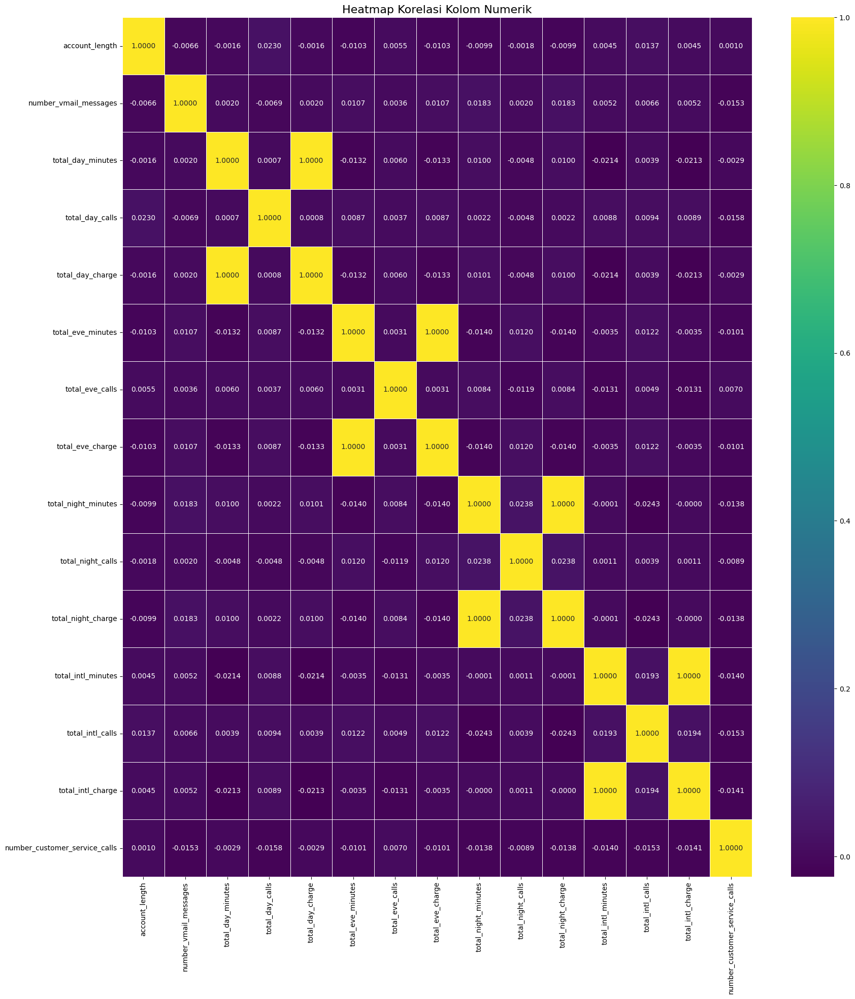

In [ ]:
plt.figure(figsize=(20,22))
sns.heatmap(data=corr, annot=True, cmap='viridis', fmt='.4f', linewidths=.5)
plt.title('Heatmap Korelasi Kolom Numerik', fontsize='16')
plt.show()

#**Preprocessing**

Pada tahap ini akan dilakukan preprocessing pada dua data (dengan outliers/df_train dan tanpa outliers/df_cleaned)

In [ ]:
df_cleaned = df_ubah.copy()

##**Standarisasi/Normalisasi**

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
def standarisasi(data):
  scaler = StandardScaler()
  data_standarisasi = pd.DataFrame(scaler.fit_transform(data.loc[:, kolom_numerik.columns].values), columns=kolom_numerik.columns)
  return pd.concat([data_standarisasi, data[['state', 'area_code', 'international_plan', 'voice_mail_plan', 'churn']]], axis=1)

####**df_train**

In [ ]:
df_train = standarisasi(df_train)

In [ ]:
df_train.head()

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,state,area_code,international_plan,voice_mail_plan,churn
0,0.170399,1.366857,-0.345510,1.163449,-0.345788,-0.093025,0.141841,-0.092493,1.070003,0.157309,1.070820,1.247901,-0.579164,1.248591,-0.426346,OH,area_code_415,no,yes,no
1,0.926186,-0.567911,1.169136,0.710014,1.169295,-1.571820,0.493490,-1.572341,-0.753320,0.207083,-0.752053,0.704379,0.232927,0.698342,-1.188960,NJ,area_code_415,no,no,no
2,-0.409038,-0.567911,2.206058,-1.456398,2.206218,-2.752070,-0.611691,-2.752473,-0.072057,-0.539526,-0.072337,-1.324770,1.045017,-1.328187,0.336268,OH,area_code_408,yes,no,no
3,-0.635774,-0.567911,-0.251076,0.659633,-0.251027,-1.032448,1.096316,-1.031447,-0.270676,1.053239,-0.270956,-0.056552,-0.579164,-0.053219,1.098882,OK,area_code_415,yes,no,no
4,0.523099,1.218029,0.702522,-0.599910,0.702027,2.952139,0.393019,2.951497,0.239775,0.903917,0.241038,-0.998657,1.045017,-0.992669,1.098882,MA,area_code_510,no,yes,no


####**df_cleaned**

In [ ]:
df_cleaned = standarisasi(df_cleaned)

In [ ]:
df_cleaned.head()

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,state,area_code,international_plan,voice_mail_plan,churn
0,0.172555,1.393905,-0.347524,1.173701,-0.347808,-0.094493,0.142097,-0.093956,1.081030,0.158633,1.081840,1.280685,-0.604467,1.282018,-0.428360,OH,area_code_415,no,yes,no
1,0.931543,-0.570844,1.174129,0.715617,1.174311,-1.582835,0.496089,-1.583389,-0.760286,0.208817,-0.758980,0.720322,0.277588,0.714403,-1.332074,NJ,area_code_415,no,no,no
2,-0.409336,-0.570844,2.215848,-1.473006,2.216049,-2.725633,-0.616458,-2.725209,-0.072300,-0.543937,-0.072573,-1.371696,1.159643,-1.376081,0.475354,OH,area_code_408,yes,no,no
3,-0.637032,-0.570844,-0.252654,0.664719,-0.252607,-1.039981,1.102932,-1.038992,-0.272879,1.061938,-0.273146,-0.064185,-0.604467,-0.060876,1.379067,OK,area_code_415,yes,no,no
4,0.526749,1.242771,0.705356,-0.607737,0.704873,2.710922,0.394948,2.709335,0.242609,0.911387,0.243888,-1.035479,1.159643,-1.029975,1.379067,MA,area_code_510,no,yes,no


##**Feature Engineering**

###**Feature Encoding (Label Encoder & One-Hot Encoder)**

In [ ]:
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder, OneHotEncoder

In [ ]:
def label_encode(data):
  le = LabelEncoder()

  for i in kolom_kategorik.columns:
    data[i] = le.fit_transform(data[i])
  return data

In [ ]:
def onehot(data):
  return pd.get_dummies(data, columns=['area_code'], dtype=int, prefix='area_code')

####**df_train**

In [ ]:
df_train = label_encode(df_train)
df_train = onehot(df_train)
df_train = df_train.rename(columns={'area_code_0':'area_code_408', 'area_code_1':'area_code_415', 'area_code_2':'area_code_510'})

In [ ]:
df_train.head()

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,...,total_intl_calls,total_intl_charge,number_customer_service_calls,state,international_plan,voice_mail_plan,churn,area_code_408,area_code_415,area_code_510
0,0.170399,1.366857,-0.345510,1.163449,-0.345788,-0.093025,0.141841,-0.092493,1.070003,0.157309,...,-0.579164,1.248591,-0.426346,35,0,1,0,0,1,0
1,0.926186,-0.567911,1.169136,0.710014,1.169295,-1.571820,0.493490,-1.572341,-0.753320,0.207083,...,0.232927,0.698342,-1.188960,31,0,0,0,0,1,0
2,-0.409038,-0.567911,2.206058,-1.456398,2.206218,-2.752070,-0.611691,-2.752473,-0.072057,-0.539526,...,1.045017,-1.328187,0.336268,35,1,0,0,1,0,0
3,-0.635774,-0.567911,-0.251076,0.659633,-0.251027,-1.032448,1.096316,-1.031447,-0.270676,1.053239,...,-0.579164,-0.053219,1.098882,36,1,0,0,0,1,0
4,0.523099,1.218029,0.702522,-0.599910,0.702027,2.952139,0.393019,2.951497,0.239775,0.903917,...,1.045017,-0.992669,1.098882,19,0,1,0,0,0,1


####**df_cleaned**

In [ ]:
df_cleaned = label_encode(df_cleaned)
df_cleaned = onehot(df_cleaned)
df_cleaned = df_cleaned.rename(columns={'area_code_0':'area_code_408', 'area_code_1':'area_code_415', 'area_code_2':'area_code_510'})

In [ ]:
df_cleaned.head()

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,...,total_intl_calls,total_intl_charge,number_customer_service_calls,state,international_plan,voice_mail_plan,churn,area_code_408,area_code_415,area_code_510
0,0.172555,1.393905,-0.347524,1.173701,-0.347808,-0.094493,0.142097,-0.093956,1.081030,0.158633,...,-0.604467,1.282018,-0.428360,35,0,1,0,0,1,0
1,0.931543,-0.570844,1.174129,0.715617,1.174311,-1.582835,0.496089,-1.583389,-0.760286,0.208817,...,0.277588,0.714403,-1.332074,31,0,0,0,0,1,0
2,-0.409336,-0.570844,2.215848,-1.473006,2.216049,-2.725633,-0.616458,-2.725209,-0.072300,-0.543937,...,1.159643,-1.376081,0.475354,35,1,0,0,1,0,0
3,-0.637032,-0.570844,-0.252654,0.664719,-0.252607,-1.039981,1.102932,-1.038992,-0.272879,1.061938,...,-0.604467,-0.060876,1.379067,36,1,0,0,0,1,0
4,0.526749,1.242771,0.705356,-0.607737,0.704873,2.710922,0.394948,2.709335,0.242609,0.911387,...,1.159643,-1.029975,1.379067,19,0,1,0,0,0,1


###**Feature Selection**

Pada tahap ini akan dilakukan penghapusan pada kolom state.

####**df_train**

In [ ]:
df_train = df_train.drop(columns='state')

In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4250 entries, 0 to 4249
Data columns (total 21 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   account_length                 4250 non-null   float64
 1   number_vmail_messages          4250 non-null   float64
 2   total_day_minutes              4250 non-null   float64
 3   total_day_calls                4250 non-null   float64
 4   total_day_charge               4250 non-null   float64
 5   total_eve_minutes              4250 non-null   float64
 6   total_eve_calls                4250 non-null   float64
 7   total_eve_charge               4250 non-null   float64
 8   total_night_minutes            4250 non-null   float64
 9   total_night_calls              4250 non-null   float64
 10  total_night_charge             4250 non-null   float64
 11  total_intl_minutes             4250 non-null   float64
 12  total_intl_calls               4250 non-null   f

####**df_cleaned**

In [ ]:
df_cleaned = df_cleaned.drop(columns='state')

In [ ]:
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4250 entries, 0 to 4249
Data columns (total 21 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   account_length                 4250 non-null   float64
 1   number_vmail_messages          4250 non-null   float64
 2   total_day_minutes              4250 non-null   float64
 3   total_day_calls                4250 non-null   float64
 4   total_day_charge               4250 non-null   float64
 5   total_eve_minutes              4250 non-null   float64
 6   total_eve_calls                4250 non-null   float64
 7   total_eve_charge               4250 non-null   float64
 8   total_night_minutes            4250 non-null   float64
 9   total_night_calls              4250 non-null   float64
 10  total_night_charge             4250 non-null   float64
 11  total_intl_minutes             4250 non-null   float64
 12  total_intl_calls               4250 non-null   f

##**Balancing Data**

In [ ]:
from imblearn.over_sampling import SMOTE, SMOTEN

####**df_train**

In [ ]:
df_train['churn'].value_counts()

churn
0    3652
1     598
Name: count, dtype: int64

In [ ]:
x_df_train = df_train.drop(columns='churn')
y_df_train = df_train.loc[:, 'churn']

In [ ]:
x_df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4250 entries, 0 to 4249
Data columns (total 20 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   account_length                 4250 non-null   float64
 1   number_vmail_messages          4250 non-null   float64
 2   total_day_minutes              4250 non-null   float64
 3   total_day_calls                4250 non-null   float64
 4   total_day_charge               4250 non-null   float64
 5   total_eve_minutes              4250 non-null   float64
 6   total_eve_calls                4250 non-null   float64
 7   total_eve_charge               4250 non-null   float64
 8   total_night_minutes            4250 non-null   float64
 9   total_night_calls              4250 non-null   float64
 10  total_night_charge             4250 non-null   float64
 11  total_intl_minutes             4250 non-null   float64
 12  total_intl_calls               4250 non-null   f

In [ ]:
y_df_train.info()

<class 'pandas.core.series.Series'>
RangeIndex: 4250 entries, 0 to 4249
Series name: churn
Non-Null Count  Dtype
--------------  -----
4250 non-null   int64
dtypes: int64(1)
memory usage: 33.3 KB


In [ ]:
sampler = SMOTE(random_state=0)
x_res_df_train, y_res_df_train = sampler.fit_resample(x_df_train, y_df_train)

In [ ]:
#hasil setelah di balancing data
res = pd.DataFrame(y_res_df_train)
res['churn'].value_counts()

churn
0    3652
1    3652
Name: count, dtype: int64

####**df_cleaned**

In [ ]:
df_cleaned['churn'].value_counts()

churn
0    3652
1     598
Name: count, dtype: int64

In [ ]:
x_df_cleaned = df_cleaned.drop(columns='churn')
y_df_cleaned = df_cleaned.loc[:, 'churn']

In [ ]:
x_df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4250 entries, 0 to 4249
Data columns (total 20 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   account_length                 4250 non-null   float64
 1   number_vmail_messages          4250 non-null   float64
 2   total_day_minutes              4250 non-null   float64
 3   total_day_calls                4250 non-null   float64
 4   total_day_charge               4250 non-null   float64
 5   total_eve_minutes              4250 non-null   float64
 6   total_eve_calls                4250 non-null   float64
 7   total_eve_charge               4250 non-null   float64
 8   total_night_minutes            4250 non-null   float64
 9   total_night_calls              4250 non-null   float64
 10  total_night_charge             4250 non-null   float64
 11  total_intl_minutes             4250 non-null   float64
 12  total_intl_calls               4250 non-null   f

In [ ]:
y_df_cleaned.info()

<class 'pandas.core.series.Series'>
RangeIndex: 4250 entries, 0 to 4249
Series name: churn
Non-Null Count  Dtype
--------------  -----
4250 non-null   int64
dtypes: int64(1)
memory usage: 33.3 KB


In [ ]:
sampler = SMOTE(random_state=0)
x_res_df_cleaned, y_res_df_cleaned = sampler.fit_resample(x_df_cleaned, y_df_cleaned)

In [ ]:
#hasil setelah di balancing data
res = pd.DataFrame(y_res_df_cleaned)
res['churn'].value_counts()

churn
0    3652
1    3652
Name: count, dtype: int64

##**Split Data (80:20)**

In [ ]:
from sklearn.model_selection import train_test_split

####**df_train**

In [ ]:
x_train_df_train, x_test_df_train, y_train_df_train, y_test_df_train = train_test_split(x_res_df_train, y_res_df_train, test_size=0.2, random_state=42)

In [ ]:
x_train_df_train_df = pd.DataFrame(x_train_df_train)
x_test_df_train_df = pd.DataFrame(x_test_df_train)
y_train_df_train_df = pd.DataFrame(y_train_df_train)
y_test_df_train_df = pd.DataFrame(y_test_df_train)

In [ ]:
print(f'jumlah baris x_train: {x_train_df_train_df.shape[0]}, jumlah kolom x_train: {x_train_df_train_df.shape[1]}')
print(f'jumlah baris x_test: {x_test_df_train_df.shape[0]}, jumlah kolom x_test: {x_test_df_train_df.shape[1]}')
print(f'jumlah baris y_train: {y_train_df_train_df.shape[0]}, jumlah kolom y_train: {y_train_df_train_df.shape[1]}')
print(f'jumlah baris y_test: {y_test_df_train_df.shape[0]}, jumlah kolom y_test: {y_test_df_train_df.shape[1]}')

jumlah baris x_train: 5843, jumlah kolom x_train: 20
jumlah baris x_test: 1461, jumlah kolom x_test: 20
jumlah baris y_train: 5843, jumlah kolom y_train: 1
jumlah baris y_test: 1461, jumlah kolom y_test: 1


####**df_cleaned**

In [ ]:
x_train_df_cleaned, x_test_df_cleaned, y_train_df_cleaned, y_test_df_cleaned = train_test_split(x_res_df_cleaned, y_res_df_cleaned, test_size=0.2, random_state=42)

In [ ]:
x_train_df_cleaned_df = pd.DataFrame(x_train_df_cleaned)
x_test_df_cleaned_df = pd.DataFrame(x_test_df_cleaned)
y_train_df_cleaned_df = pd.DataFrame(y_train_df_cleaned)
y_test_df_cleaned_df = pd.DataFrame(y_test_df_cleaned)

In [ ]:
print(f'jumlah baris x_train: {x_train_df_cleaned_df.shape[0]}, jumlah kolom x_train: {x_train_df_cleaned_df.shape[1]}')
print(f'jumlah baris x_test: {x_test_df_cleaned_df.shape[0]}, jumlah kolom x_test: {x_test_df_cleaned_df.shape[1]}')
print(f'jumlah baris y_train: {y_train_df_cleaned_df.shape[0]}, jumlah kolom y_train: {y_train_df_cleaned_df.shape[1]}')
print(f'jumlah baris y_test: {y_test_df_cleaned_df.shape[0]}, jumlah kolom y_test: {y_test_df_cleaned_df.shape[1]}')

jumlah baris x_train: 5843, jumlah kolom x_train: 20
jumlah baris x_test: 1461, jumlah kolom x_test: 20
jumlah baris y_train: 5843, jumlah kolom y_train: 1
jumlah baris y_test: 1461, jumlah kolom y_test: 1


#**Modeling**

##**Random Forest**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

####**df_train**

In [ ]:
model_randomforest_df_train = RandomForestClassifier()

In [ ]:
model_randomforest_df_train.fit(x_train_df_train, y_train_df_train)

RandomForestClassifier()

In [ ]:
y_pred_df_train_rf = model_randomforest_df_train.predict(x_test_df_train)

In [ ]:
test_accuracy_rf_df_train = accuracy_score(y_test_df_train, y_pred_df_train_rf)
print("Akurasi Test Model Random Forest:", test_accuracy_rf_df_train)

Akurasi Test Model Random Forest: 0.9691991786447639


####**df_cleaned**

In [ ]:
model_randomforest_df_cleaned = RandomForestClassifier()

In [ ]:
model_randomforest_df_cleaned.fit(x_train_df_cleaned, y_train_df_cleaned)

RandomForestClassifier()

In [ ]:
y_pred_df_cleaned_rf = model_randomforest_df_cleaned.predict(x_test_df_cleaned)

In [ ]:
test_accuracy_rf_df_cleaned = accuracy_score(y_test_df_cleaned, y_pred_df_cleaned_rf)
print("Akurasi Test Model Random Forest:", test_accuracy_rf_df_cleaned)

Akurasi Test Model Random Forest: 0.9630390143737166


##**Decision Tree**

In [ ]:
from sklearn.tree import DecisionTreeClassifier

####**df_train**

In [ ]:
model_decisiontree_df_train = DecisionTreeClassifier(random_state=42)

In [ ]:
model_decisiontree_df_train.fit(x_train_df_train, y_train_df_train)

DecisionTreeClassifier(random_state=42)

In [ ]:
y_pred_df_train_dt = model_decisiontree_df_train.predict(x_test_df_train)

In [ ]:
test_accuracy_dt_df_train = accuracy_score(y_test_df_train, y_pred_df_train_dt)
print("Akurasi Test Model Decision Tree:", test_accuracy_dt_df_train)

Akurasi Test Model Decision Tree: 0.9356605065023956


####**df_cleaned**

In [ ]:
model_decisiontree_df_cleaned = DecisionTreeClassifier(random_state=42)

In [ ]:
model_decisiontree_df_cleaned.fit(x_train_df_cleaned, y_train_df_cleaned)

DecisionTreeClassifier(random_state=42)

In [ ]:
y_pred_df_cleaned_dt = model_decisiontree_df_cleaned.predict(x_test_df_cleaned)

In [ ]:
test_accuracy_dt_df_cleaned = accuracy_score(y_test_df_cleaned, y_pred_df_cleaned_dt)
print("Akurasi Test Model Decision Tree:", test_accuracy_dt_df_cleaned)

Akurasi Test Model Decision Tree: 0.9295003422313484


##**SVM**

In [ ]:
from sklearn.svm import SVC

####**df_train**

In [ ]:
model_svm_df_train = SVC(random_state=42)

In [ ]:
model_svm_df_train.fit(x_train_df_train, y_train_df_train)

SVC(random_state=42)

In [ ]:
y_pred_df_train_svm = model_svm_df_train.predict(x_test_df_train)

In [ ]:
test_accuracy_svm_df_train = accuracy_score(y_test_df_train, y_pred_df_train_svm)
print("Akurasi Test Model SVM:", test_accuracy_svm_df_train)

Akurasi Test Model SVM: 0.917864476386037


####**df_cleaned**

In [ ]:
model_svm_df_cleaned = SVC(random_state=42)

In [ ]:
model_svm_df_cleaned.fit(x_train_df_cleaned, y_train_df_cleaned)

SVC(random_state=42)

In [ ]:
y_pred_df_cleaned_svm = model_svm_df_cleaned.predict(x_test_df_cleaned)

In [ ]:
test_accuracy_svm_df_cleaned = accuracy_score(y_test_df_cleaned, y_pred_df_cleaned_svm)
print("Akurasi Test Model SVM:", test_accuracy_svm_df_cleaned)

Akurasi Test Model SVM: 0.9137577002053389


#**Evaluasi Model**

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

####**df_train**

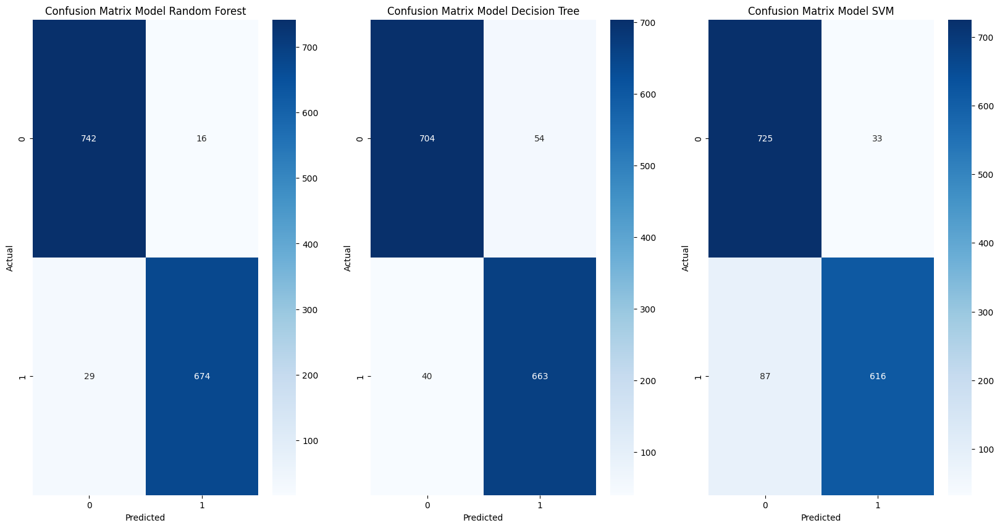

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(20, 10))

#random forest
cm_rf_df_train = confusion_matrix(y_test_df_train, y_pred_df_train_rf)
sns.heatmap(cm_rf_df_train, annot=True, fmt="d", cmap="Blues", ax=ax[0])
ax[0].set_xlabel('Predicted')
ax[0].set_ylabel('Actual')
ax[0].set_title('Confusion Matrix Model Random Forest')

#decision tree
cm_dt_df_train = confusion_matrix(y_test_df_train, y_pred_df_train_dt)
sns.heatmap(cm_dt_df_train, annot=True, fmt="d", cmap="Blues", ax=ax[1])
ax[1].set_xlabel('Predicted')
ax[1].set_ylabel('Actual')
ax[1].set_title('Confusion Matrix Model Decision Tree')

#svm
cm_svm_df_train = confusion_matrix(y_test_df_train, y_pred_df_train_svm)
sns.heatmap(cm_svm_df_train, annot=True, fmt="d", cmap="Blues", ax=ax[2])
ax[2].set_xlabel('Predicted')
ax[2].set_ylabel('Actual')
ax[2].set_title('Confusion Matrix Model SVM')

plt.show()

In [ ]:
report_rf_df_train = classification_report(y_test_df_train, y_pred_df_train_rf, digits=4)
print("Classification Report Model Random Forest:\n", report_rf_df_train)
report_dt_df_train = classification_report(y_test_df_train, y_pred_df_train_dt, digits=4)
print("Classification Report Model Decision Tree:\n", report_dt_df_train)
report_svm_df_train = classification_report(y_test_df_train, y_pred_df_train_svm, digits=4)
print("Classification Report Model SVM:\n", report_svm_df_train)

Classification Report Model Random Forest:
               precision    recall  f1-score   support

           0     0.9624    0.9789    0.9706       758
           1     0.9768    0.9587    0.9677       703

    accuracy                         0.9692      1461
   macro avg     0.9696    0.9688    0.9691      1461
weighted avg     0.9693    0.9692    0.9692      1461

Classification Report Model Decision Tree:
               precision    recall  f1-score   support

           0     0.9462    0.9288    0.9374       758
           1     0.9247    0.9431    0.9338       703

    accuracy                         0.9357      1461
   macro avg     0.9355    0.9359    0.9356      1461
weighted avg     0.9359    0.9357    0.9357      1461

Classification Report Model SVM:
               precision    recall  f1-score   support

           0     0.8929    0.9565    0.9236       758
           1     0.9492    0.8762    0.9112       703

    accuracy                         0.9179      1461
   mac

####**df_cleaned**

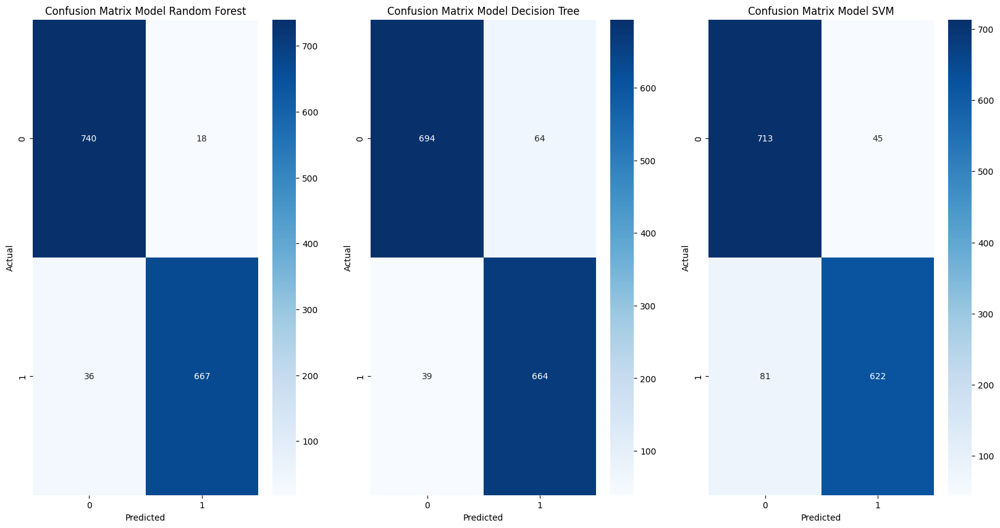

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(20, 10))

#random forest
cm_rf_df_cleaned = confusion_matrix(y_test_df_cleaned, y_pred_df_cleaned_rf)
sns.heatmap(cm_rf_df_cleaned, annot=True, fmt="d", cmap="Blues", ax=ax[0])
ax[0].set_xlabel('Predicted')
ax[0].set_ylabel('Actual')
ax[0].set_title('Confusion Matrix Model Random Forest')

#decision tree
cm_dt_df_cleaned = confusion_matrix(y_test_df_cleaned, y_pred_df_cleaned_dt)
sns.heatmap(cm_dt_df_cleaned, annot=True, fmt="d", cmap="Blues", ax=ax[1])
ax[1].set_xlabel('Predicted')
ax[1].set_ylabel('Actual')
ax[1].set_title('Confusion Matrix Model Decision Tree')

#svm
cm_svm_df_cleaned = confusion_matrix(y_test_df_cleaned, y_pred_df_cleaned_svm)
sns.heatmap(cm_svm_df_cleaned, annot=True, fmt="d", cmap="Blues", ax=ax[2])
ax[2].set_xlabel('Predicted')
ax[2].set_ylabel('Actual')
ax[2].set_title('Confusion Matrix Model SVM')

plt.show()

In [ ]:
report_rf_df_cleaned = classification_report(y_test_df_cleaned, y_pred_df_cleaned_rf, digits=4)
print("Classification Report Model Random Forest:\n", report_rf_df_cleaned)
report_dt_df_cleaned = classification_report(y_test_df_cleaned, y_pred_df_cleaned_dt, digits=4)
print("Classification Report Model Decision Tree:\n", report_dt_df_cleaned)
report_svm_df_cleaned = classification_report(y_test_df_cleaned, y_pred_df_cleaned_svm, digits=4)
print("Classification Report Model SVM:\n", report_svm_df_cleaned)

Classification Report Model Random Forest:
               precision    recall  f1-score   support

           0     0.9536    0.9763    0.9648       758
           1     0.9737    0.9488    0.9611       703

    accuracy                         0.9630      1461
   macro avg     0.9637    0.9625    0.9629      1461
weighted avg     0.9633    0.9630    0.9630      1461

Classification Report Model Decision Tree:
               precision    recall  f1-score   support

           0     0.9468    0.9156    0.9309       758
           1     0.9121    0.9445    0.9280       703

    accuracy                         0.9295      1461
   macro avg     0.9294    0.9300    0.9295      1461
weighted avg     0.9301    0.9295    0.9295      1461

Classification Report Model SVM:
               precision    recall  f1-score   support

           0     0.8980    0.9406    0.9188       758
           1     0.9325    0.8848    0.9080       703

    accuracy                         0.9138      1461
   mac

#**Prediction**

Pada tahap ini akan dilakukan prediksi terhadap data test terpisah.

In [ ]:
df_test = pd.read_csv('/content/drive/MyDrive/Latihan Analisis Data /FGA/FGA-DATA SCIENCE-BINAR/Data Test.csv')

In [ ]:
df_test.head()

,id,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
0,1,KS,128,area_code_415,no,yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1
1,2,AL,118,area_code_510,yes,no,0,223.4,98,37.98,220.6,101,18.75,203.9,118,9.18,6.3,6,1.70,0
2,3,IA,62,area_code_415,no,no,0,120.7,70,20.52,307.2,76,26.11,203.0,99,9.14,13.1,6,3.54,4
3,4,VT,93,area_code_510,no,no,0,190.7,114,32.42,218.2,111,18.55,129.6,121,5.83,8.1,3,2.19,3
4,5,NE,174,area_code_415,no,no,0,124.3,76,21.13,277.1,112,23.55,250.7,115,11.28,15.5,5,4.19,3


In [ ]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 750 entries, 0 to 749
Data columns (total 20 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   id                             750 non-null    int64  
 1   state                          750 non-null    object 
 2   account_length                 750 non-null    int64  
 3   area_code                      750 non-null    object 
 4   international_plan             750 non-null    object 
 5   voice_mail_plan                750 non-null    object 
 6   number_vmail_messages          750 non-null    int64  
 7   total_day_minutes              750 non-null    float64
 8   total_day_calls                750 non-null    int64  
 9   total_day_charge               750 non-null    float64
 10  total_eve_minutes              750 non-null    float64
 11  total_eve_calls                750 non-null    int64  
 12  total_eve_charge               750 non-null    flo

In [ ]:
def standarisasi(data):
  scaler = StandardScaler()
  data_standarisasi = pd.DataFrame(scaler.fit_transform(data.loc[:, kolom_numerik.columns].values), columns=kolom_numerik.columns)
  return pd.concat([data_standarisasi, data[['state', 'area_code', 'international_plan', 'voice_mail_plan']]], axis=1)

In [ ]:
data_test = standarisasi(df_test)

In [ ]:
def label_encode(data):
  le = LabelEncoder()

  for i in ['state', 'area_code', 'international_plan', 'voice_mail_plan']:
    data[i] = le.fit_transform(data[i])
  return data

In [ ]:
data_test = label_encode(data_test)
data_test = onehot(data_test)
data_test = data_test.rename(columns={'area_code_0':'area_code_408', 'area_code_1':'area_code_415', 'area_code_2':'area_code_510'})
data_test = data_test.drop(columns='state')

In [ ]:
data_test.head()

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,international_plan,voice_mail_plan,area_code_408,area_code_415,area_code_510
0,0.696065,1.172240,1.590391,0.470870,1.590686,-0.112333,-0.065790,-0.112140,0.875401,-0.488757,0.874772,-0.106243,-0.613702,-0.106976,-0.497639,0,1,0,1,0
1,0.444001,-0.599015,0.806892,-0.138101,0.807063,0.332531,0.037545,0.332287,0.083122,0.919514,0.085085,-1.442710,0.625821,-1.445297,-1.281734,1,0,0,0,1
2,-0.967554,-0.599015,-1.122731,-1.559032,-1.122705,1.993104,-1.254136,1.992682,0.065645,-0.071491,0.067824,1.013500,0.625821,1.017213,1.854646,0,0,0,1,0
3,-0.186157,-0.599015,0.192494,0.673860,0.192544,0.286511,0.554217,0.287167,-1.359681,1.075989,-1.360517,-0.792537,-0.613702,-0.789520,1.070551,0,0,0,0,1
4,1.855557,-0.599015,-1.055091,-1.254547,-1.055285,1.415931,0.605885,1.415153,0.991913,0.763040,0.991283,1.880397,0.212647,1.887122,1.070551,0,0,0,1,0


##**Random Forest**

####**df_train**

In [ ]:
prediksi_model_randomforest_df_train = model_randomforest_df_train.predict(data_test)

In [ ]:
data_prediksi_rf_df_train = pd.DataFrame({'id':df_test['id'], 'prediksi_churn':prediksi_model_randomforest_df_train})
data_prediksi_rf_df_train['prediksi_churn'] = data_prediksi_rf_df_train['prediksi_churn'].map({0:'no', 1:'yes'})
data_prediksi_rf_df_train

,id,prediksi_churn
0,1,no
1,2,no
2,3,yes
3,4,no
4,5,no
...,...,...
745,746,no
746,747,no
747,748,no
748,749,no


In [ ]:
data_prediksi_rf_df_train['prediksi_churn'].value_counts()

prediksi_churn
no     622
yes    128
Name: count, dtype: int64

####**df_cleaned**

In [ ]:
prediksi_model_randomforest_df_cleaned = model_randomforest_df_cleaned.predict(data_test)

In [ ]:
data_prediksi_rf_df_cleaned = pd.DataFrame({'id':df_test['id'], 'prediksi_churn':prediksi_model_randomforest_df_cleaned})
data_prediksi_rf_df_cleaned['prediksi_churn'] = data_prediksi_rf_df_cleaned['prediksi_churn'].map({0:'no', 1:'yes'})
data_prediksi_rf_df_cleaned

,id,prediksi_churn
0,1,no
1,2,no
2,3,yes
3,4,no
4,5,no
...,...,...
745,746,no
746,747,no
747,748,no
748,749,no


In [ ]:
data_prediksi_rf_df_cleaned['prediksi_churn'].value_counts()

prediksi_churn
no     631
yes    119
Name: count, dtype: int64

##**Decision Tree**

####**df_train**

In [ ]:
prediksi_model_decisiontree_df_train = model_decisiontree_df_train.predict(data_test)

In [ ]:
data_prediksi_dt_df_train = pd.DataFrame({'id':df_test['id'], 'prediksi_churn':prediksi_model_decisiontree_df_train})
data_prediksi_dt_df_train['prediksi_churn'] = data_prediksi_dt_df_train['prediksi_churn'].map({0:'no', 1:'yes'})
data_prediksi_dt_df_train

,id,prediksi_churn
0,1,no
1,2,no
2,3,yes
3,4,yes
4,5,yes
...,...,...
745,746,no
746,747,yes
747,748,yes
748,749,yes


In [ ]:
data_prediksi_dt_df_train['prediksi_churn'].value_counts()

prediksi_churn
yes    543
no     207
Name: count, dtype: int64

####**df_cleaned**

In [ ]:
prediksi_model_decisiontree_df_cleaned = model_decisiontree_df_cleaned.predict(data_test)

In [ ]:
data_prediksi_dt_df_cleaned = pd.DataFrame({'id':df_test['id'], 'prediksi_churn':prediksi_model_decisiontree_df_cleaned})
data_prediksi_dt_df_cleaned['prediksi_churn'] = data_prediksi_dt_df_cleaned['prediksi_churn'].map({0:'no', 1:'yes'})
data_prediksi_dt_df_cleaned

,id,prediksi_churn
0,1,no
1,2,no
2,3,yes
3,4,yes
4,5,yes
...,...,...
745,746,no
746,747,yes
747,748,yes
748,749,no


In [ ]:
data_prediksi_dt_df_cleaned['prediksi_churn'].value_counts()

prediksi_churn
yes    384
no     366
Name: count, dtype: int64

##**SVM**

####**df_train**

In [ ]:
prediksi_model_svm_df_train = model_svm_df_train.predict(data_test)

In [ ]:
data_prediksi_svm_df_train = pd.DataFrame({'id':df_test['id'], 'prediksi_churn':prediksi_model_svm_df_train})
data_prediksi_svm_df_train['prediksi_churn'] = data_prediksi_svm_df_train['prediksi_churn'].map({0:'no', 1:'yes'})
data_prediksi_svm_df_train

,id,prediksi_churn
0,1,no
1,2,no
2,3,no
3,4,no
4,5,no
...,...,...
745,746,no
746,747,no
747,748,no
748,749,no


In [ ]:
data_prediksi_svm_df_train['prediksi_churn'].value_counts()

prediksi_churn
no     641
yes    109
Name: count, dtype: int64

####**df_cleaned**

In [ ]:
prediksi_model_svm_df_cleaned = model_svm_df_cleaned.predict(data_test)

In [ ]:
data_prediksi_svm_df_cleaned = pd.DataFrame({'id':df_test['id'], 'prediksi_churn':prediksi_model_svm_df_cleaned})
data_prediksi_svm_df_cleaned['prediksi_churn'] = data_prediksi_svm_df_cleaned['prediksi_churn'].map({0:'no', 1:'yes'})
data_prediksi_svm_df_cleaned

,id,prediksi_churn
0,1,no
1,2,no
2,3,yes
3,4,no
4,5,no
...,...,...
745,746,no
746,747,no
747,748,no
748,749,no


In [ ]:
data_prediksi_svm_df_cleaned['prediksi_churn'].value_counts()

prediksi_churn
no     635
yes    115
Name: count, dtype: int64

**Kesimpulan:** berdasarkan hasil performa masing-masing model telah menunjukkan bahwa data ber-outliers tingkat akurasinya lebih tinggi daripada data tanpa outliers. Hal ini dapat disimpulkan bahwa adanya outliers belum tentu dapat memberikan hasil yang tidak akurat, bisa jadi adanya outliers dapat memperkaya data sehingga performa yang dihasilkan model dapat lebih baik.